# 20250722 Root Atlas cNMF GEP GO analysis
This runs within the muscat Conda environment
Analyzes the results in 20250722_root_atlas_cnmf.ipynb

In [1]:
# Check the conda env running, it's important that you're running in the correct conda env
# Don't change anything here
Sys.getenv("CONDA_DEFAULT_ENV")

[1] "muscat"

In [2]:
# Change the path to your own directory
rm(list=ls())
setwd('/resnick/groups/NolanLab/cchen/mannitol/cnmf/20250722_root_atlas_cnmf')


In [3]:
# Load the libraries
# Don't change anything here
suppressMessages(library(GeneOverlap))
suppressMessages(library(gprofiler2))
suppressMessages(library(tidyverse))
suppressMessages(library(ComplexHeatmap))
suppressMessages(library(circlize))
suppressMessages(library(Seurat))

In [4]:
# Check the loaded packages and their versions. 
# # Be sure to execute this! It's important for reproducibility and debugging
# Don't change anything here
sessionInfo()

R version 4.3.3 (2024-02-29)
Platform: x86_64-conda-linux-gnu (64-bit)
Running under: Red Hat Enterprise Linux 9.5 (Plow)

Matrix products: default
BLAS/LAPACK: /resnick/groups/NolanLab/cchen/miniconda3/envs/muscat/lib/libopenblasp-r0.3.27.so;  LAPACK version 3.12.0

locale:
 [1] LC_CTYPE=C.UTF-8           LC_NUMERIC=C              
 [3] LC_TIME=en_US.UTF-8        LC_COLLATE=en_US.UTF-8    
 [5] LC_MONETARY=en_US.UTF-8    LC_MESSAGES=en_US.UTF-8   
 [7] LC_PAPER=en_US.UTF-8       LC_NAME=C                 
 [9] LC_ADDRESS=C               LC_TELEPHONE=C            
[11] LC_MEASUREMENT=en_US.UTF-8 LC_IDENTIFICATION=C       

time zone: America/Los_Angeles
tzcode source: system (glibc)

attached base packages:
[1] grid      stats     graphics  grDevices utils     datasets  methods  
[8] base     

other attached packages:
 [1] Seurat_5.2.1          SeuratObject_5.0.2    sp_2.2-0             
 [4] circlize_0.4.16       ComplexHeatmap_2.18.0 lubridate_1.9.4      
 [7] forcats_1.0.0         

In [5]:
# Read in GEP score
GEP_score_raw <- read.table("20250722_root_atlas_cnmf_parallel/20250722_root_atlas_cnmf_parallel.gene_spectra_score.k_30.dt_0_1.txt", 
                   header = T)

In [6]:
head(GEP_score_raw, 3)

,AT1G01010,AT1G01020,AT1G03987,AT1G01030,AT1G01040,AT1G01050,AT1G01060,AT1G01070,AT1G04003,AT1G01080,⋯,AT2G07860,AT2G08040,AT2G39851,AT2G42835,AT4G03580,AT4G04815,AT4G08485,AT4G06380,AT4G21030,AT4G09045
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,-0.0009181087,-3.582355e-05,-6.010676e-06,5.955127e-05,-3.277432e-04,0.0007601265,-3.389594e-04,-0.0003825735,-3.540773e-06,-0.0002075873,⋯,0,-6.079081e-05,0,0,-2.652584e-05,9.547121e-05,0,-3.885398e-05,0,9.241401e-06
2,-0.0004486164,2.682098e-04,-4.108028e-06,-1.261800e-04,-9.303128e-05,0.0012164017,5.476103e-05,-0.0001940035,-1.323077e-05,0.0001045421,⋯,0,3.285920e-04,0,0,1.495957e-05,-1.505614e-05,0,5.341547e-05,0,-3.415716e-06
3,-0.0009037018,-2.327463e-04,4.602577e-05,9.230912e-05,-1.327719e-04,-0.0007541299,-5.152976e-04,-0.0004510174,-2.586985e-05,-0.0002557728,⋯,0,3.557958e-06,0,0,7.854490e-05,-2.970420e-05,0,2.710244e-06,0,-1.305505e-05


In [7]:
GEP_score <- as.data.frame(t(GEP_score_raw))

In [8]:
head(GEP_score, 3)

,1,2,3,4,5,6,7,8,9,10,⋯,21,22,23,24,25,26,27,28,29,30
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AT1G01010,-9.181087e-04,-4.486164e-04,-9.037018e-04,5.322456e-05,1.878345e-05,-1.629325e-04,-5.377264e-04,-5.258016e-04,2.931742e-03,-6.148138e-05,⋯,-2.979482e-06,-6.110111e-04,-1.510016e-04,1.029368e-04,-2.267858e-04,3.507503e-04,-1.677782e-04,-1.491155e-04,-1.151191e-04,2.233542e-04
AT1G01020,-3.582355e-05,2.682098e-04,-2.327463e-04,-1.341628e-04,7.734951e-04,-1.128617e-04,1.238245e-04,-4.020132e-04,2.879971e-04,-1.836733e-04,⋯,2.454857e-04,-2.581357e-05,-1.463696e-04,1.477867e-04,1.615548e-04,3.322189e-04,-3.408717e-05,1.418923e-04,7.106826e-05,-2.479525e-05
AT1G03987,-6.010676e-06,-4.108028e-06,4.602577e-05,-1.051816e-05,-7.882518e-06,-8.413725e-06,-1.071538e-05,-1.024367e-05,-7.762036e-06,7.104151e-08,⋯,-8.789088e-06,-4.693212e-06,-4.245099e-06,-8.146777e-06,-1.398544e-06,9.708034e-07,-3.479765e-06,-6.700524e-06,-8.340389e-07,-8.712404e-07


In [9]:
colnames(GEP_score) <- paste0("GEP_", colnames(GEP_score))

In [10]:
head(GEP_score, 3)

,GEP_1,GEP_2,GEP_3,GEP_4,GEP_5,GEP_6,GEP_7,GEP_8,GEP_9,GEP_10,⋯,GEP_21,GEP_22,GEP_23,GEP_24,GEP_25,GEP_26,GEP_27,GEP_28,GEP_29,GEP_30
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AT1G01010,-9.181087e-04,-4.486164e-04,-9.037018e-04,5.322456e-05,1.878345e-05,-1.629325e-04,-5.377264e-04,-5.258016e-04,2.931742e-03,-6.148138e-05,⋯,-2.979482e-06,-6.110111e-04,-1.510016e-04,1.029368e-04,-2.267858e-04,3.507503e-04,-1.677782e-04,-1.491155e-04,-1.151191e-04,2.233542e-04
AT1G01020,-3.582355e-05,2.682098e-04,-2.327463e-04,-1.341628e-04,7.734951e-04,-1.128617e-04,1.238245e-04,-4.020132e-04,2.879971e-04,-1.836733e-04,⋯,2.454857e-04,-2.581357e-05,-1.463696e-04,1.477867e-04,1.615548e-04,3.322189e-04,-3.408717e-05,1.418923e-04,7.106826e-05,-2.479525e-05
AT1G03987,-6.010676e-06,-4.108028e-06,4.602577e-05,-1.051816e-05,-7.882518e-06,-8.413725e-06,-1.071538e-05,-1.024367e-05,-7.762036e-06,7.104151e-08,⋯,-8.789088e-06,-4.693212e-06,-4.245099e-06,-8.146777e-06,-1.398544e-06,9.708034e-07,-3.479765e-06,-6.700524e-06,-8.340389e-07,-8.712404e-07


In [11]:
GEP_score <- GEP_score %>%
    rownames_to_column("gene_ID")

In [12]:
 head(GEP_score, 3)

,gene_ID,GEP_1,GEP_2,GEP_3,GEP_4,GEP_5,GEP_6,GEP_7,GEP_8,GEP_9,⋯,GEP_21,GEP_22,GEP_23,GEP_24,GEP_25,GEP_26,GEP_27,GEP_28,GEP_29,GEP_30
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,AT1G01010,-9.181087e-04,-4.486164e-04,-9.037018e-04,5.322456e-05,1.878345e-05,-1.629325e-04,-5.377264e-04,-5.258016e-04,2.931742e-03,⋯,-2.979482e-06,-6.110111e-04,-1.510016e-04,1.029368e-04,-2.267858e-04,3.507503e-04,-1.677782e-04,-1.491155e-04,-1.151191e-04,2.233542e-04
2,AT1G01020,-3.582355e-05,2.682098e-04,-2.327463e-04,-1.341628e-04,7.734951e-04,-1.128617e-04,1.238245e-04,-4.020132e-04,2.879971e-04,⋯,2.454857e-04,-2.581357e-05,-1.463696e-04,1.477867e-04,1.615548e-04,3.322189e-04,-3.408717e-05,1.418923e-04,7.106826e-05,-2.479525e-05
3,AT1G03987,-6.010676e-06,-4.108028e-06,4.602577e-05,-1.051816e-05,-7.882518e-06,-8.413725e-06,-1.071538e-05,-1.024367e-05,-7.762036e-06,⋯,-8.789088e-06,-4.693212e-06,-4.245099e-06,-8.146777e-06,-1.398544e-06,9.708034e-07,-3.479765e-06,-6.700524e-06,-8.340389e-07,-8.712404e-07


In [13]:
sum(is.na(GEP_score))

[1] 0

In [14]:
GEP_list <- list()
for (i in seq(1,30)){
    ls <- GEP_score %>% arrange(desc(GEP_score[[i+1]])) %>%  slice_head(n = 9) %>% select(gene_ID) 
    GEP_list <- append(GEP_list, list(ls$gene_ID))
}

In [15]:
names(GEP_list) <- paste0("GEP_",seq(1,30))

In [16]:
GEP_list

$GEP_1
[1] "AT5G10130" "AT1G54010" "AT4G37160" "AT2G43610" "AT2G23630" "AT5G58784"
[7] "AT1G28290" "AT1G54030" "AT1G80240"

$GEP_2
[1] "AT2G19730" "AT5G02960" "AT3G62870" "AT5G15200" "AT4G16720" "AT3G09200"
[7] "AT2G32060" "AT3G07110" "AT5G27850"

$GEP_3
[1] "AT1G50060" "AT4G27400" "AT1G25275" "AT3G61930" "AT5G54370" "AT2G36950"
[7] "AT5G20230" "AT5G64250" "AT4G17500"

$GEP_4
[1] "AT1G77690" "AT2G13820" "AT1G12080" "AT5G03960" "AT2G46890" "AT5G05690"
[7] "AT1G19968" "AT3G18780" "AT3G48970"

$GEP_5
[1] "AT1G03850" "AT2G43820" "AT5G17460" "AT5G49450" "AT4G33666" "AT4G33467"
[7] "AT5G63600" "AT2G15960" "AT5G03210"

$GEP_6
[1] "AT1G12090" "AT2G45180" "AT1G20190" "AT5G13930" "AT1G76090" "AT1G20010"
[7] "AT1G12845" "AT1G78570" "AT2G06850"

$GEP_7
[1] "AT1G05660" "AT2G43890" "AT3G08030" "AT2G33790" "AT1G13590" "AT5G40330"
[7] "AT3G21680" "AT3G28910" "AT1G53130"

$GEP_8
[1] "AT4G30450" "AT4G33550" "AT1G20160" "AT3G53980" "AT2G30860" "AT4G30460"
[7] "AT1G02500" "AT3G25190" "AT1G22410"

$GEP_9
[1] "AT3G60450" "AT3G03990" "AT1G10370" "AT2G30400" "AT3G16330" "AT2G22860"
[7] "AT2G38240" "AT1G76410" "AT5G15960"

$GEP_10
[1] "AT1G05260" "AT4G11290" "AT5G57620" "AT2G22000" "AT4G05100" "AT2G14900"
[7] "AT5G65790" "AT4G22110" "AT1G69930"

$GEP_11
[1] "AT2G39530" "AT1G65310" "AT1G06120" "AT5G46900" "AT4G22666" "AT1G70850"
[7] "AT4G23400" "AT4G30280" "AT4G12510"

$GEP_12
[1] "AT5G19240" "AT1G13930" "AT4G37010" "AT5G15180" "AT4G13860" "AT1G79040"
[7] "AT3G44310" "AT3G14850" "AT5G09978"

$GEP_13
[1] "AT5G47920" "AT1G26450" "AT3G14780" "AT5G37660" "AT5G24800" "AT4G23410"
[7] "AT3G15680" "AT4G18340" "AT5G23370"

$GEP_14
[1] "AT5G57560" "AT4G27280" "AT5G42380" "AT3G57450" "AT1G07135" "AT2G02010"
[7] "AT5G54490" "AT2G26530" "AT3G23250"

$GEP_15
[1] "AT2G36100" "AT4G17215" "AT5G42180" "AT1G30750" "AT2G32300" "AT1G61590"
[7] "AT3G11550" "AT5G65530" "AT2G40113"

$GEP_16
[1] "AT3G16440" "AT3G20160" "AT1G47600" "AT1G06090" "AT3G06460" "AT1G51470"
[7] "AT3G49190" "AT2G23410" "AT3G03500"

$GEP_17
[1] "AT2G47540" "AT4G22217" "AT1G53680" "AT1G27140" "AT3G16390" "AT3G02230"
[7] "AT1G23750" "AT4G01480" "AT5G11440"

$GEP_18
[1] "AT2G04025" "AT4G34970" "AT1G04610" "AT5G57420" "AT1G18265" "AT2G28900"
[7] "AT1G13620" "AT3G60650" "AT1G18250"

$GEP_19
[1] "AT1G54575" "AT5G04080" "AT5G43380" "AT5G63850" "AT5G27690" "AT5G02600"
[7] "AT5G50720" "AT3G04300" "AT2G16740"

$GEP_20
[1] "AT4G40090" "AT4G02270" "AT1G62980" "AT4G25820" "AT2G03720" "AT4G00680"
[7] "AT5G67400" "AT4G30320" "AT3G60280"

$GEP_21
[1] "AT5G12020" "AT5G12030" "AT1G54050" "AT2G29500" "AT1G53540" "AT4G25200"
[7] "AT1G07400" "AT2G26150" "AT3G24500"

$GEP_22
[1] "AT5G02640" "AT5G50950" "AT1G55210" "AT1G68810" "AT3G21270" "AT4G36160"
[7] "AT4G23690" "AT3G10080" "AT1G03820"

$GEP_23
[1] "AT2G28760" "AT2G28315" "AT5G12870" "AT4G18780" "AT5G15630" "AT3G53620"
[7] "AT5G67230" "AT2G17710" "AT3G27200"

$GEP_24
[1] "AT5G65360" "AT1G07820" "AT3G27360" "AT3G45980" "AT5G10400" "AT1G54690"
[7] "AT2G28740" "AT5G59870" "AT3G53650"

$GEP_25
[1] "AT4G13420" "AT4G22690" "AT1G67980" "AT1G02930" "AT3G47480" "AT3G60415"
[7] "AT2G30750" "AT2G43510" "AT1G02920"

$GEP_26
[1] "AT3G01940" "AT3G01680" "AT3G17730" "AT5G46530" "AT1G29520" "AT5G18970"
[7] "AT1G08160" "AT3G49360" "AT1G06490"

$GEP_27
[1] "AT5G48920" "AT4G22920" "AT1G43790" "AT3G21550" "AT4G18425" "AT5G59845"
[7] "AT5G07080" "AT3G49070" "AT5G19870"

$GEP_28
[1] "AT1G50490" "AT5G16250" "AT3G51280" "AT5G66230" "AT3G11520" "AT5G06150"
[7] "AT3G51720" "AT4G31840" "AT5G15510"

$GEP_29
[1] "AT1G61760" "AT1G54400" "AT2G34530" "AT5G41470" "AT4G00890" "AT2G42820"
[7] "AT1G77700" "AT3G13590" "AT3G18260"

$GEP_30
[1] "AT1G64000" "AT5G09530" "AT4G38080" "AT1G55990" "AT4G14440" "AT3G06390"
[7] "AT3G51642" "AT1G03700" "AT3G55870"

In [17]:
## Top 9 genes for each GEP will be unique
sum(sort(table(as.character(unlist(GEP_list))))>1)

[1] 0

In [18]:
length(as.character(unlist(GEP_list)))

[1] 270

In [19]:
## For GO analysis, choose top 200 genes for each GEP
GEP_list <- list()
for (i in seq(1,30)){
    ls <- GEP_score %>% arrange(desc(GEP_score[[i+1]])) %>%  slice_head(n = 200) %>% select(gene_ID) 
    GEP_list <- append(GEP_list, list(ls$gene_ID))
}

In [20]:
names(GEP_list) <- paste0("GEP_",seq(1,30))

In [21]:
GEP_list

$GEP_1
  [1] "AT5G10130" "AT1G54010" "AT4G37160" "AT2G43610" "AT2G23630" "AT5G58784"
  [7] "AT1G28290" "AT1G54030" "AT1G80240" "AT3G04320" "AT5G35940" "AT3G16410"
 [13] "AT2G43600" "AT5G13870" "AT2G41800" "AT4G15300" "AT2G47140" "AT2G17280"
 [19] "AT5G12940" "AT2G04160" "AT5G62340" "AT1G14220" "AT1G06330" "AT4G23590"
 [25] "AT4G01770" "AT4G01950" "AT3G14530" "AT1G54000" "AT1G07175" "AT1G78340"
 [31] "AT5G60520" "AT3G29430" "AT2G30340" "AT5G26260" "AT4G21902" "AT4G14560"
 [37] "AT5G26280" "AT4G38140" "AT4G10350" "AT1G44318" "AT2G25980" "AT5G47950"
 [43] "AT4G24340" "AT1G66280" "AT3G14550" "AT4G15350" "AT5G02260" "AT4G15215"
 [49] "AT3G20940" "AT1G12740" "AT5G40780" "AT1G66400" "AT3G16420" "AT1G66800"
 [55] "AT3G16450" "AT1G44760" "AT5G44440" "AT2G43535" "AT5G36880" "AT4G01240"
 [61] "AT1G14080" "AT3G16430" "AT5G63650" "AT4G16500" "AT5G26230" "AT1G72140"
 [67] "AT4G30610" "AT5G23210" "AT2G39350" "AT2G35770" "AT4G30810" "AT1G01720"
 [73] "AT1G22190" "AT5G24070" "AT4G20000" "AT5G08590" "AT5G66690" "AT5G66800"
 [79] "AT5G41810" "AT4G36010" "AT4G31320" "AT4G24275" "AT3G10720" "AT4G00360"
 [85] "AT1G02390" "AT3G62650" "AT2G40470" "AT3G51600" "AT4G00400" "AT3G14510"
 [91] "AT4G30080" "AT1G33750" "AT5G23820" "AT1G31950" "AT2G45050" "AT1G73340"
 [97] "AT4G36250" "AT1G47620" "AT4G11610" "AT1G23160" "AT3G15950" "AT2G23110"
[103] "AT3G47380" "AT1G75710" "AT3G16460" "AT1G65730" "AT2G38750" "AT3G46080"
[109] "AT1G74490" "AT5G45280" "AT1G52690" "AT5G15265" "AT1G76600" "AT1G55850"
[115] "AT3G45730" "AT2G32190" "AT5G57090" "AT3G07320" "AT1G69040" "AT3G46700"
[121] "AT3G53990" "AT3G04330" "AT1G53700" "AT5G39080" "AT1G52060" "AT5G15940"
[127] "AT1G62570" "AT1G48330" "AT2G41290" "AT5G37770" "AT4G00080" "AT3G59850"
[133] "AT1G16905" "AT4G31290" "AT5G66460" "AT5G42630" "AT1G05530" "AT4G37770"
[139] "AT5G10480" "AT1G79580" "AT5G14730" "AT5G48900" "AT3G45600" "AT5G59030"
[145] "AT3G05500" "AT5G18310" "AT2G38940" "AT5G56980" "AT2G43290" "AT1G76680"
[151] "AT4G20820" "AT2G14960" "AT3G12955" "AT2G39200" "AT3G02110" "AT1G50720"
[157] "AT1G56630" "AT3G15810" "AT3G19930" "AT2G40475" "AT5G07040" "AT1G32540"
[163] "AT2G22770" "AT1G20696" "AT2G45400" "AT3G50740" "AT2G32210" "AT4G04745"
[169] "AT1G52910" "AT3G23470" "AT1G10560" "AT3G10815" "AT3G29250" "AT2G19460"
[175] "AT5G23840" "AT4G39660" "AT1G80830" "AT5G06320" "AT3G49630" "AT5G08790"
[181] "AT3G30775" "AT2G20515" "AT1G67730" "AT1G07280" "AT5G14750" "AT3G09260"
[187] "AT5G05410" "AT3G44450" "AT4G15760" "AT2G30130" "AT4G22010" "AT3G45310"
[193] "AT5G24610" "AT1G65980" "AT5G42600" "AT1G14210" "AT5G65683" "AT2G24570"
[199] "AT1G18210" "AT3G23410"

$GEP_2
  [1] "AT2G19730" "AT5G02960" "AT3G62870" "AT5G15200" "AT4G16720" "AT3G09200"
  [7] "AT2G32060" "AT3G07110" "AT5G27850" "AT4G18730" "AT1G02780" "AT4G27090"
 [13] "AT5G16130" "AT5G20290" "AT2G39460" "AT2G01250" "AT2G18020" "AT5G23740"
 [19] "AT1G77940" "AT4G17390" "AT1G27400" "AT1G15930" "AT3G55750" "AT1G08360"
 [25] "AT2G34480" "AT3G56340" "AT3G53740" "AT3G60245" "AT3G62250" "AT5G39740"
 [31] "AT2G27530" "AT5G61170" "AT1G14320" "AT3G16080" "AT2G21580" "AT1G22780"
 [37] "AT2G36160" "AT3G09500" "AT1G48630" "AT2G37270" "AT5G47700" "AT5G56710"
 [43] "AT2G36620" "AT5G47930" "AT1G09690" "AT1G34030" "AT5G18380" "AT1G70600"
 [49] "AT5G04800" "AT5G45775" "AT3G60770" "AT3G02560" "AT3G28900" "AT3G59540"
 [55] "AT5G27700" "AT1G72370" "AT5G41520" "AT3G22230" "AT3G47370" "AT5G60670"
 [61] "AT3G25520" "AT3G04840" "AT5G58420" "AT4G39200" "AT5G28060" "AT2G43460"
 [67] "AT4G00100" "AT4G25740" "AT1G57660" "AT3G23390" "AT4G10450" "AT3G52590"
 [73] "AT1G33120" "AT4G31700" "AT3G04400" "AT5G52650" "AT1G43170" "AT4G18100"
 [79] "AT4G12600" "AT3G45030" "AT2G44120" "AT1G69620" "AT3G53020" "AT3G11510"
 [85] "AT1G04480" "AT2G37190" "AT1G33140" "AT5G22440" "AT3G05560" "AT4G36130"
 [91] "AT3G18740" "AT4G00810" "AT3G55280" "AT5G64140" "AT2G47610" "AT3G06700"
 [97] "AT4G15000" "AT1G09590" "AT5G57290" "AT5G59850" "AT2G33370" "AT2G36170"
[103] "AT3G11940" "AT5G02610" "AT2G41840" "AT3G05590" "

In [22]:
# Perform GO analysis
cluster_GO <- gost(GEP_list, organism = "athaliana", correction_method = "fdr", significant = F, multi_query = F)

cluster_GO_df <- cluster_GO[[1]] # the result data frame

cluster_GO_sig <- filter(cluster_GO_df, p_value<=0.01)

In [23]:
head(cluster_GO_sig, 3)

,query,significant,p_value,term_size,query_size,intersection_size,precision,recall,term_id,source,term_name,effective_domain_size,source_order,parents
,<chr>,<lgl>,<dbl>,<int>,<int>,<int>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<int>,<int>,<list>
1,GEP_1,TRUE,0.007873161,629,145,15,0.1034483,0.02384738,GO:0008610,GO:BP,lipid biosynthetic process,21925,3192,GO:00066....
2,GEP_1,TRUE,0.007873161,2940,145,38,0.2620690,0.01292517,GO:0042221,GO:BP,response to chemical,21925,9956,GO:0050896
3,GEP_1,TRUE,0.007873161,1097,145,20,0.1379310,0.01823154,GO:0006629,GO:BP,lipid metabolic process,21925,2334,GO:0044238


In [24]:
sort(unique(cluster_GO_sig$query))

[1] "GEP_1"  "GEP_10" "GEP_11" "GEP_12" "GEP_13" "GEP_14" "GEP_15" "GEP_16"
 [9] "GEP_17" "GEP_18" "GEP_19" "GEP_2"  "GEP_20" "GEP_21" "GEP_22" "GEP_23"
[17] "GEP_24" "GEP_25" "GEP_26" "GEP_27" "GEP_28" "GEP_29" "GEP_3"  "GEP_30"
[25] "GEP_4"  "GEP_5"  "GEP_6"  "GEP_7"  "GEP_8"  "GEP_9"

In [25]:
# top  terms for each cluster

cluster_GO_sig %>%
  filter(source=="GO:BP", intersection_size>=4) %>%
  group_by(query) %>%
  top_n(5, wt = -p_value) %>%
  arrange(desc(p_value)) -> top_GO

GO_n <- cluster_GO_sig %>%
  filter(source=="GO:BP", intersection_size>=4) %>%
  group_by(term_id) %>%
  tally() %>%
  arrange(desc(n))


GO_n <- dplyr::rename(GO_n, "n_clusters"=n)

cluster_GO_sig_n <- left_join(cluster_GO_sig, GO_n)

# get all terms for the top ones so that all clusters have values

top_GO_all <- filter(cluster_GO_df, term_id %in% top_GO$term_id)


#spread and plot


top_GO_sel <- select(top_GO_all, query, p_value, term_id, term_name)

spread_GO <- spread(top_GO_sel, key = query, p_value)

spread_GO[is.na(spread_GO)] <- 1

spread_GO_m <- as.matrix(-log10(spread_GO[3:ncol(spread_GO)]))
rownames(spread_GO_m) <- spread_GO$term_name

Joining with `by = join_by(term_id)`


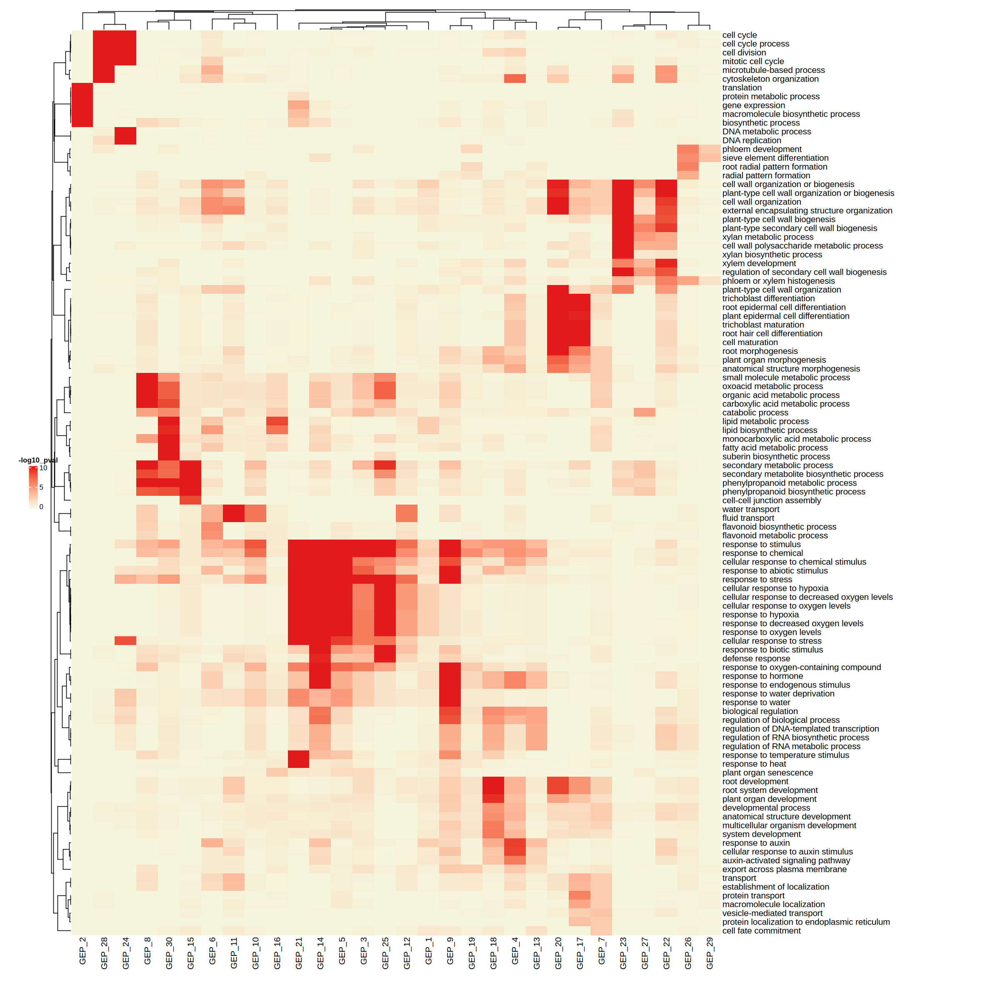

In [26]:
options(repr.plot.width = 20, repr.plot.height = 20)

GO_hm <- Heatmap(spread_GO_m, 
                 name = "-log10_pval", 
                 heatmap_legend_param = list(title_position="topcenter", color_bar = "continuous"), 
                 col = colorRamp2(c(0, 10), 
                                  c("beige", "#e31a1c")), 
                 cluster_rows = T,
                 cluster_columns = T, 
                 use_raster= FALSE, 
                 show_column_names = TRUE, 
                 show_row_names = TRUE, 
                 show_row_dend = TRUE, 
                 show_column_dend = TRUE, 
                 clustering_distance_rows = "pearson",
                 clustering_distance_columns = "pearson", 
                 row_names_gp = gpar(fontsize = 12)) 


# padding - bottom, left, top, right
draw(GO_hm, padding = unit(c(15, 15, 5, 80), "mm"), heatmap_legend_side = "left")

In [27]:
getwd()

[1] "/resnick/groups/NolanLab/cchen/mannitol/cnmf/20250722_root_atlas_cnmf"

In [28]:
head(spread_GO)

,term_id,term_name,GEP_1,GEP_10,GEP_11,GEP_12,GEP_13,GEP_14,GEP_15,GEP_16,⋯,GEP_28,GEP_29,GEP_3,GEP_30,GEP_4,GEP_5,GEP_6,GEP_7,GEP_8,GEP_9
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,GO:0000278,mitotic cell cycle,1.000000000,1.00000000,1.00000000,1.000000e+00,1.0000000000,1.000000e+00,1.0000000,1.00000000,⋯,1.656482e-32,0.9860805,1.000000e+00,7.471481e-01,0.36567404,1.000000e+00,0.0103292,1.00000000,1.000000e+00,1.0000000000
2,GO:0001666,response to hypoxia,0.008568784,0.67627425,0.90535798,3.256667e-05,0.4932206146,9.649602e-41,0.3203484,0.89009059,⋯,1.000000e+00,1.0000000,3.728821e-07,6.970266e-01,0.59935653,1.963899e-14,0.9322904,0.45451009,1.000000e+00,0.1112759458
3,GO:0006082,organic acid metabolic process,0.316765040,0.10836682,0.07780494,2.811062e-01,0.4525963152,2.361847e-03,0.1299891,0.03005019,⋯,1.000000e+00,1.0000000,1.652159e-03,1.687448e-08,0.38597795,1.234134e-01,0.1195624,0.01329521,4.443228e-17,0.0088613142
4,GO:0006259,DNA metabolic process,1.000000000,0.99129690,1.00000000,1.000000e+00,1.0000000000,1.000000e+00,0.9969347,1.00000000,⋯,4.673976e-01,0.9593055,9.954154e-01,1.000000e+00,0.98144213,9.805975e-01,0.9729743,0.99280585,1.000000e+00,0.9844907236
5,GO:0006260,DNA replication,1.000000000,0.78169780,1.00000000,1.000000e+00,1.0000000000,1.000000e+00,1.0000000,1.00000000,⋯,5.545803e-02,0.9860805,1.000000e+00,1.000000e+00,0.71923409,1.000000e+00,0.8036567,1.00000000,1.000000e+00,1.0000000000
6,GO:0006355,regulation of DNA-templated transcription,0.491949051,0.08296448,1.00000000,1.000000e+00,0.0001186245,1.647069e-04,0.6833902,1.00000000,⋯,1.000000e+00,1.0000000,7.128563e-01,2.481224e-01,0.08138804,1.828872e-01,0.9945004,0.19307211,9.516024e-01,0.0001418159


In [29]:
# Save the result
#write.table(spread_GO,
#            "20250722_root_atlas_cnmf_parallel.gene_spectra_score.k_30.dt_0_1_GO.txt", sep = "\t",
#            row.names = F, col.names = T, quote = F)

## GEP usage

In [29]:
# The function to read Seurat object
# This is specifically for reading Seurat 3/4 objects in a Seurat 5 env
# Don't change anything here
read_seu <- function(dir) {
  seu <- readRDS(dir)
  seu@assays$spliced_RNA <- NULL
  seu@assays$spliced_SCT <- NULL
  seu@assays$unspliced_RNA <- NULL
  seu@assays$unspliced_SCT <- NULL
  seu <- suppressWarnings(suppressMessages(UpdateSlots(seu)))
  seu <- suppressWarnings(suppressMessages(UpdateSeuratObject(seu)))
  return(seu)
}

In [30]:
rc.integrated <- read_seu("/resnick/groups/NolanLab/shared_resources/annotated_objects/rds/integrated/Root_Atlas_v2_seu3_20220106.rds")


In [31]:
rc.integrated

An object of class Seurat 
71468 features across 110427 samples within 3 assays 
Active assay: integrated (17513 features, 17513 variable features)
 2 layers present: data, scale.data
 2 other assays present: RNA, SCT
 5 dimensional reductions calculated: pca, umap, umap_3D, umap_2D, umap_50

In [32]:
GEP_usage <- read.csv("/resnick/groups/NolanLab/cchen/mannitol/cnmf/20250722_root_atlas_cnmf/20250722_root_atlas_cnmf_parallel/20250722_root_atlas_cnmf_parallel.usages.k_30.dt_0_1.consensus.txt",
                      sep="\t")


In [33]:
head(GEP_usage)

,X,X1,X2,X3,X4,X5,X6,X7,X8,X9,⋯,X21,X22,X23,X24,X25,X26,X27,X28,X29,X30
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,AAACCCAAGCCATTCA_1,0.04893713,0.090610156,0.007496949,0.004143808,0.02813839,0.03238366,0.44500112,0.003822049,0.00000000,⋯,0.000000000,0.003786700,0.005426142,0.003614915,0,0.003510636,0.0002423366,0.00000000,0.000000e+00,0.0001246741
2,AAACCCAAGCTGTTCA_1,0.00000000,0.000000000,0.000000000,0.009822821,0.57054346,0.00000000,0.10012456,0.011877956,0.00000000,⋯,0.000000000,0.000000000,0.003494375,0.003057198,0,0.000000000,0.0042506721,0.00000000,1.512234e-05,0.0000000000
3,AAACCCAAGGCGAACT_1,0.00000000,0.000000000,0.000000000,0.000000000,0.14837877,0.54437984,0.21511212,0.000000000,0.21121791,⋯,0.000000000,0.000000000,0.000000000,0.000000000,0,0.000000000,0.0000000000,0.00000000,0.000000e+00,0.0000000000
4,AAACCCACACCAGCCA_1,0.10637848,0.010682129,0.549489400,0.000000000,0.07846621,0.01009298,0.00000000,0.002775509,0.03702748,⋯,0.008774841,0.011675368,0.000000000,0.001699086,0,0.002404297,0.0038288122,0.00000000,0.000000e+00,0.0000000000
5,AAACCCACACTGGCGT_1,0.00000000,0.008458047,0.916310036,0.000000000,0.00000000,0.00000000,0.00000000,0.000000000,0.00000000,⋯,0.000000000,0.002467955,0.009840735,0.000000000,0,0.000000000,0.0016002835,0.00154616,1.519888e-03,0.0000000000
6,AAACCCACAGACCTGC_1,0.40810441,0.148901553,0.103435620,0.000000000,0.07170737,0.00000000,0.07358418,0.000000000,0.04873583,⋯,0.000000000,0.000000000,0.002350374,0.001118176,0,0.000000000,0.0009722757,0.00000000,0.000000e+00,0.0002402171


In [34]:
# Check if the order of cell barcodes are the same
GEP_usage$X[1:5]
colnames(rc.integrated)[1:5]

[1] "AAACCCAAGCCATTCA_1" "AAACCCAAGCTGTTCA_1" "AAACCCAAGGCGAACT_1"
[4] "AAACCCACACCAGCCA_1" "AAACCCACACTGGCGT_1"

[1] "AAACCCAAGCCATTCA_1" "AAACCCAAGCTGTTCA_1" "AAACCCAAGGCGAACT_1"
[4] "AAACCCACACCAGCCA_1" "AAACCCACACTGGCGT_1"

In [35]:
# Check if the order of cell barcodes are the same
identical(GEP_usage$X, colnames(rc.integrated))


[1] TRUE

In [36]:
# Update metadata
rc.integrated$GEP_1 <- GEP_usage$X1
rc.integrated$GEP_2 <- GEP_usage$X2
rc.integrated$GEP_3 <- GEP_usage$X3
rc.integrated$GEP_4 <- GEP_usage$X4
rc.integrated$GEP_5 <- GEP_usage$X5
rc.integrated$GEP_6 <- GEP_usage$X6
rc.integrated$GEP_7 <- GEP_usage$X7
rc.integrated$GEP_8 <- GEP_usage$X8
rc.integrated$GEP_9 <- GEP_usage$X9
rc.integrated$GEP_10 <- GEP_usage$X10
rc.integrated$GEP_11 <- GEP_usage$X11
rc.integrated$GEP_12 <- GEP_usage$X12
rc.integrated$GEP_13 <- GEP_usage$X13
rc.integrated$GEP_14 <- GEP_usage$X14
rc.integrated$GEP_15 <- GEP_usage$X15
rc.integrated$GEP_16 <- GEP_usage$X16
rc.integrated$GEP_17 <- GEP_usage$X17
rc.integrated$GEP_18 <- GEP_usage$X18
rc.integrated$GEP_19 <- GEP_usage$X19
rc.integrated$GEP_20 <- GEP_usage$X20
rc.integrated$GEP_21 <- GEP_usage$X21
rc.integrated$GEP_22 <- GEP_usage$X22
rc.integrated$GEP_23 <- GEP_usage$X23
rc.integrated$GEP_24 <- GEP_usage$X24
rc.integrated$GEP_25 <- GEP_usage$X25
rc.integrated$GEP_26 <- GEP_usage$X26
rc.integrated$GEP_27 <- GEP_usage$X27
rc.integrated$GEP_28 <- GEP_usage$X28
rc.integrated$GEP_29 <- GEP_usage$X29
rc.integrated$GEP_30 <- GEP_usage$X30


In [37]:
# Chage the col name of GEP_usage
colnames(GEP_usage) <- c("cell_barcode", paste0("GEP_",seq(1,30)))

In [38]:
head(GEP_usage)

,cell_barcode,GEP_1,GEP_2,GEP_3,GEP_4,GEP_5,GEP_6,GEP_7,GEP_8,GEP_9,⋯,GEP_21,GEP_22,GEP_23,GEP_24,GEP_25,GEP_26,GEP_27,GEP_28,GEP_29,GEP_30
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,AAACCCAAGCCATTCA_1,0.04893713,0.090610156,0.007496949,0.004143808,0.02813839,0.03238366,0.44500112,0.003822049,0.00000000,⋯,0.000000000,0.003786700,0.005426142,0.003614915,0,0.003510636,0.0002423366,0.00000000,0.000000e+00,0.0001246741
2,AAACCCAAGCTGTTCA_1,0.00000000,0.000000000,0.000000000,0.009822821,0.57054346,0.00000000,0.10012456,0.011877956,0.00000000,⋯,0.000000000,0.000000000,0.003494375,0.003057198,0,0.000000000,0.0042506721,0.00000000,1.512234e-05,0.0000000000
3,AAACCCAAGGCGAACT_1,0.00000000,0.000000000,0.000000000,0.000000000,0.14837877,0.54437984,0.21511212,0.000000000,0.21121791,⋯,0.000000000,0.000000000,0.000000000,0.000000000,0,0.000000000,0.0000000000,0.00000000,0.000000e+00,0.0000000000
4,AAACCCACACCAGCCA_1,0.10637848,0.010682129,0.549489400,0.000000000,0.07846621,0.01009298,0.00000000,0.002775509,0.03702748,⋯,0.008774841,0.011675368,0.000000000,0.001699086,0,0.002404297,0.0038288122,0.00000000,0.000000e+00,0.0000000000
5,AAACCCACACTGGCGT_1,0.00000000,0.008458047,0.916310036,0.000000000,0.00000000,0.00000000,0.00000000,0.000000000,0.00000000,⋯,0.000000000,0.002467955,0.009840735,0.000000000,0,0.000000000,0.0016002835,0.00154616,1.519888e-03,0.0000000000
6,AAACCCACAGACCTGC_1,0.40810441,0.148901553,0.103435620,0.000000000,0.07170737,0.00000000,0.07358418,0.000000000,0.04873583,⋯,0.000000000,0.000000000,0.002350374,0.001118176,0,0.000000000,0.0009722757,0.00000000,0.000000e+00,0.0002402171


In [39]:
rc.integrated$time.anno.Li.crude <- gsub("_.*$","",rc.integrated$time.celltype.anno.Li.crude)
rc.integrated$celltype.anno.Li.crude <- gsub("Distal Columella","Distal Columella_Columella",rc.integrated$time.celltype.anno.Li.crude)
rc.integrated$celltype.anno.Li.crude <- gsub("Distal Lateral Root Cap","Distal Lateral Root Cap_Lateral Root Cap",rc.integrated$celltype.anno.Li.crude)
rc.integrated$celltype.anno.Li.crude <- gsub("Proximal Columella","Proximal Columella_Columella",rc.integrated$celltype.anno.Li.crude)
rc.integrated$celltype.anno.Li.crude <- gsub("Proximal Lateral Root Cap","Proximal Lateral Root Cap_Lateral Root Cap",rc.integrated$celltype.anno.Li.crude)
rc.integrated$celltype.anno.Li.crude <- gsub("^.*_","",rc.integrated$celltype.anno.Li.crude)
rc.integrated$time.anno.Li <- gsub("_.*$","",rc.integrated$time.celltype.anno.Li)
rc.integrated$celltype.anno.Li <- gsub("Distal Columella","Distal Columella_Columella",rc.integrated$time.celltype.anno.Li)
rc.integrated$celltype.anno.Li <- gsub("Distal Lateral Root Cap","Distal Lateral Root Cap_Lateral Root Cap",rc.integrated$celltype.anno.Li)
rc.integrated$celltype.anno.Li <- gsub("Proximal Columella","Proximal Columella_Columella",rc.integrated$celltype.anno.Li)
rc.integrated$celltype.anno.Li <- gsub("Proximal Lateral Root Cap","Proximal Lateral Root Cap_Lateral Root Cap",rc.integrated$celltype.anno.Li)
rc.integrated$celltype.anno.Li <- gsub("^.*_","",rc.integrated$celltype.anno.Li)

plot_anno <- function(rc.integrated){
order <- c("Quiescent Center", "Ground Tissue","Columella", "Lateral Root Cap", "Atrichoblast", "Trichoblast", "Cortex", "Endodermis", "Metaphloem & Companion Cell","Protophloem", "Xylem", "Procambium","Xylem Pole Pericycle","Phloem Pole Pericycle", "Protoxylem", "Metaxylem", "Unknown")
palette <- c("#9400d3", "#DCD0FF","#5ab953", "#bfef45", "#008080", "#21B6A8", "#82b6ff", "#0000FF","#e6194b", "#dd77ec", "#9a6324", "#ffe119", "#ff9900", "#ffd4e3", "#9a6324", "#ddaa6f", "#EEEEEE")
rc.integrated$celltype.anno.Li <- factor(rc.integrated$celltype.anno.Li, levels = order[sort(match(unique(rc.integrated$celltype.anno.Li),order))])
color <- palette[sort(match(unique(rc.integrated$celltype.anno.Li),order))]
DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.anno.Li", cols=color, pt.size=0.2,raster=FALSE)}

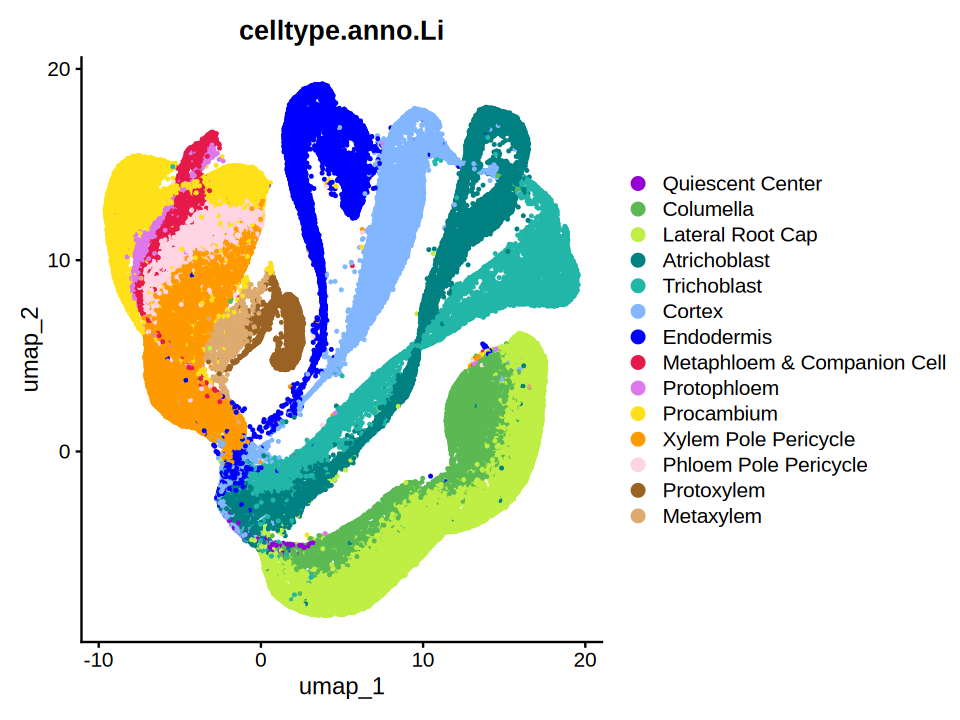

In [40]:
options(repr.plot.width=8, repr.plot.height=6)
plot_anno(rc.integrated)

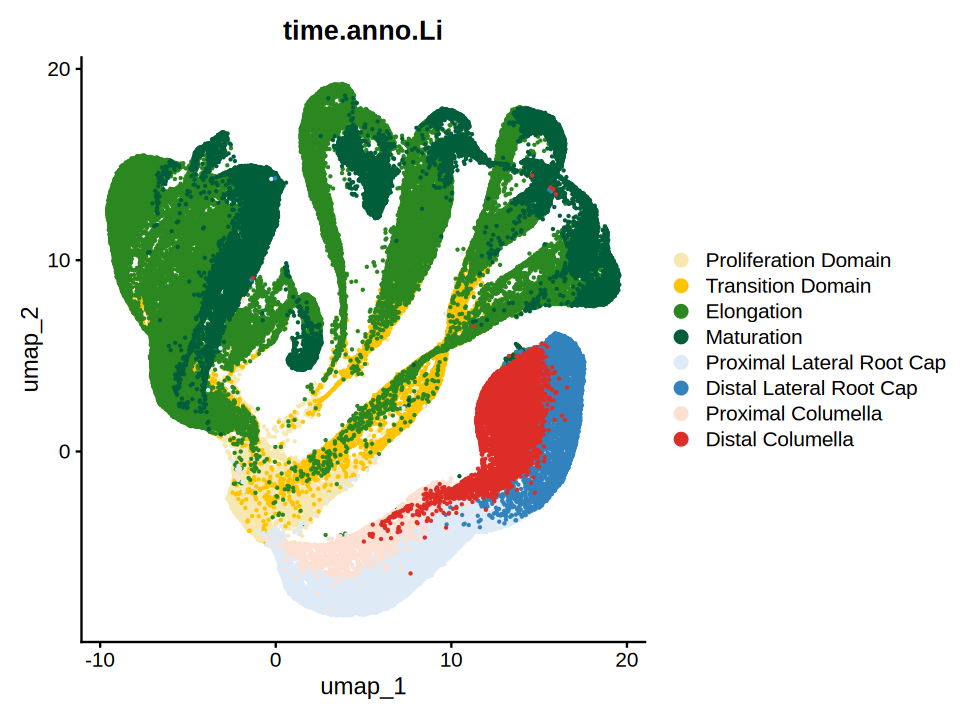

In [41]:
options(repr.plot.width=8, repr.plot.height=6)
DimPlot(rc.integrated, reduction = "umap", group.by = "time.anno.Li",order = c("Distal Columella","Proximal Columella","Distal Lateral Root Cap","Proximal Lateral Root Cap","Maturation","Elongation", "Transition Domain", "Proliferation Domain"),
        cols = c('#F7E7B0','#FFC400','#2B871F','#005E3B', "#deebf7", "#3182bd", '#fee0d2','#de2d26'),raster=FALSE)

In [42]:
Idents(rc.integrated) <- rc.integrated$time.celltype.anno.Li

In [44]:
plot_box <- function(annotation, value, title){
    # Prepare data
data <- data.frame(
  annotation = annotation,
  value = value
)

#Prepare mean values for each annotation and reorder
data <- data %>%
  group_by(annotation) %>%
  mutate(mean_value = mean(value)) %>%
  ungroup() %>%
  mutate(annotation = reorder(annotation, desc(mean_value)))
    
  options(repr.plot.width=24, repr.plot.height=12)
  # Create the boxplot
  print(ggplot(data, aes(x = annotation, y = value)) +
  geom_boxplot() +
  labs(x = "", y = "Usage", title = title) +
  theme_minimal(base_size=18) +
  theme(axis.text.x = element_text(angle = 90, hjust = 1, vjust = 0.5)) )
    
}

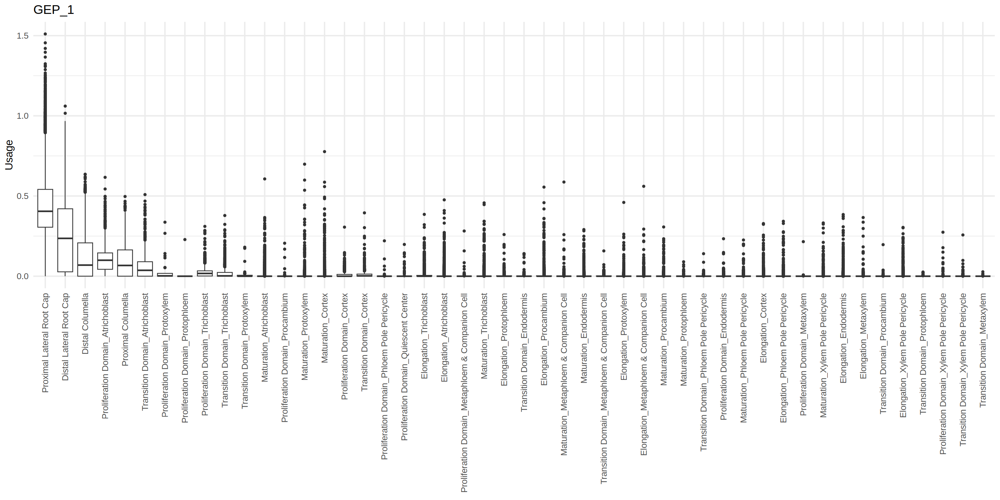

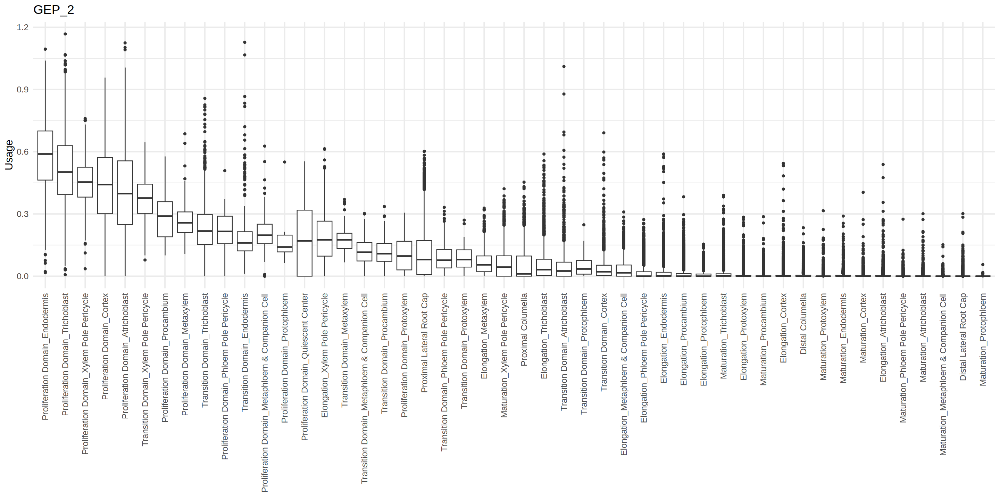

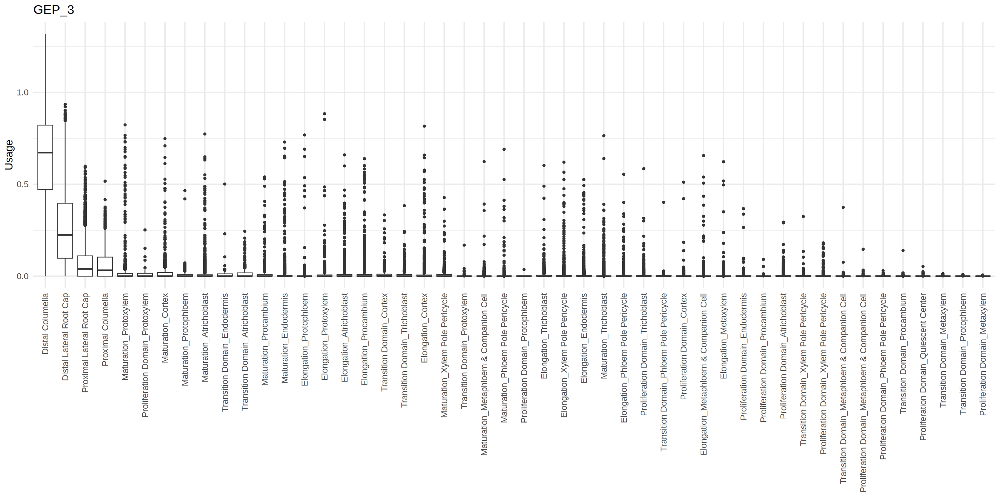

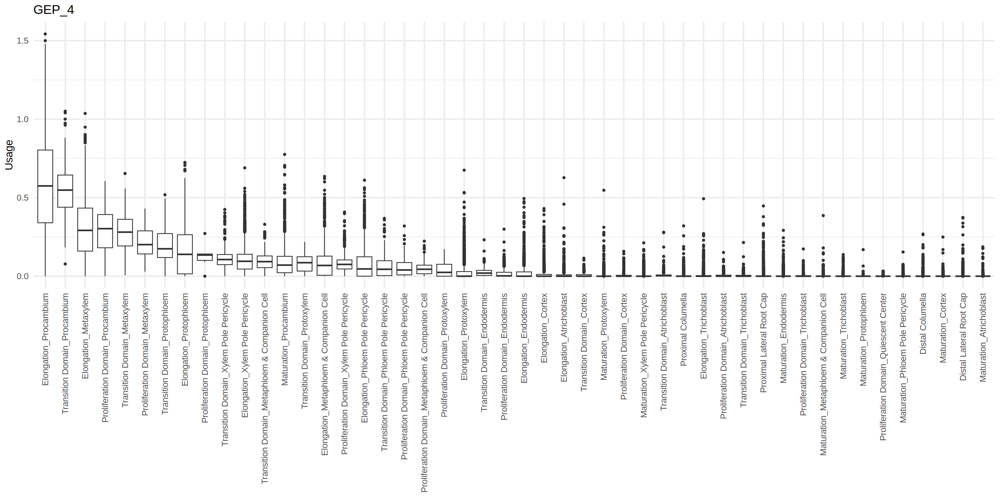

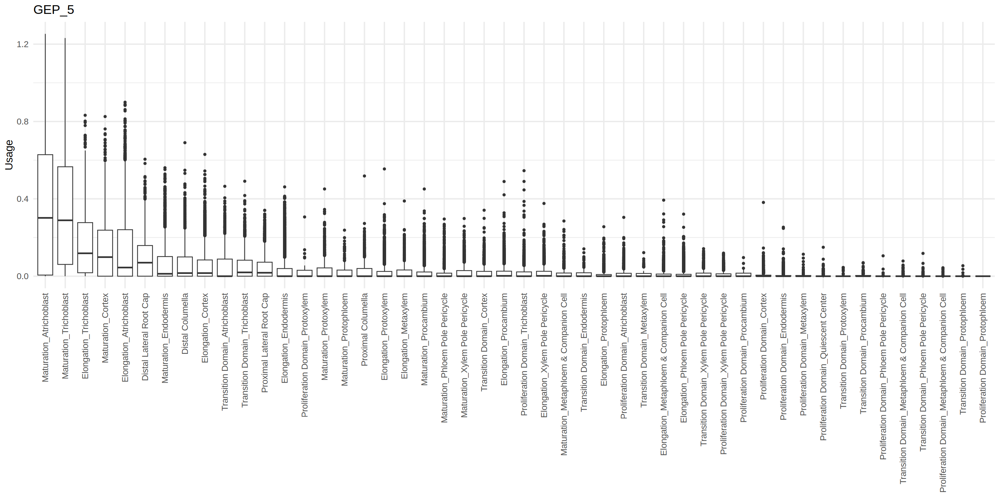

...

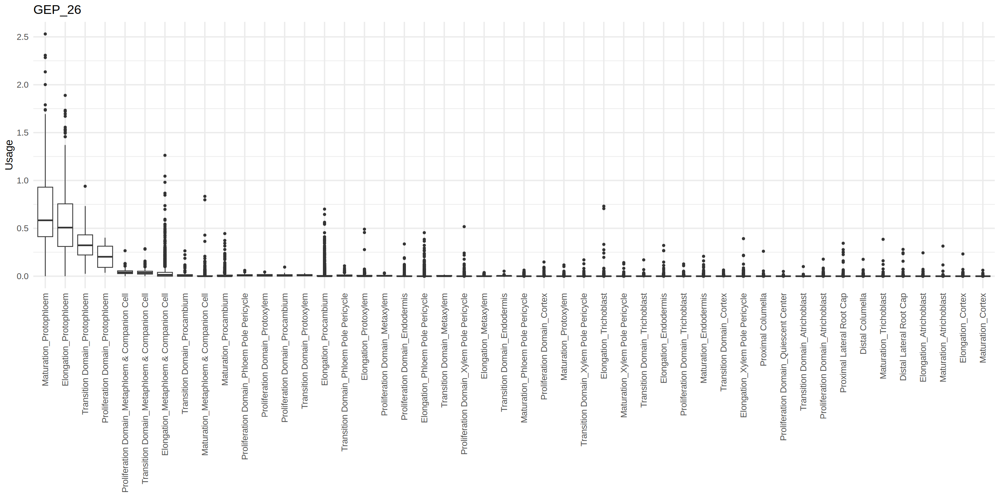

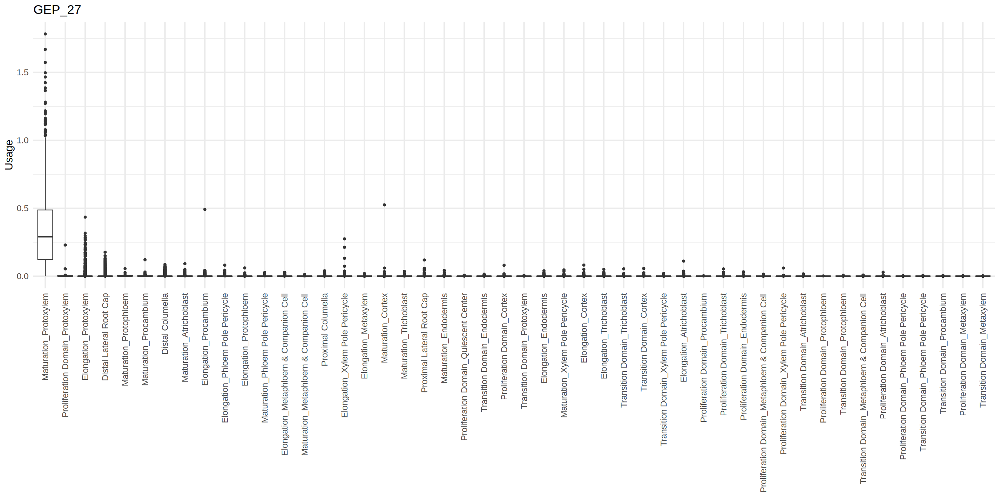

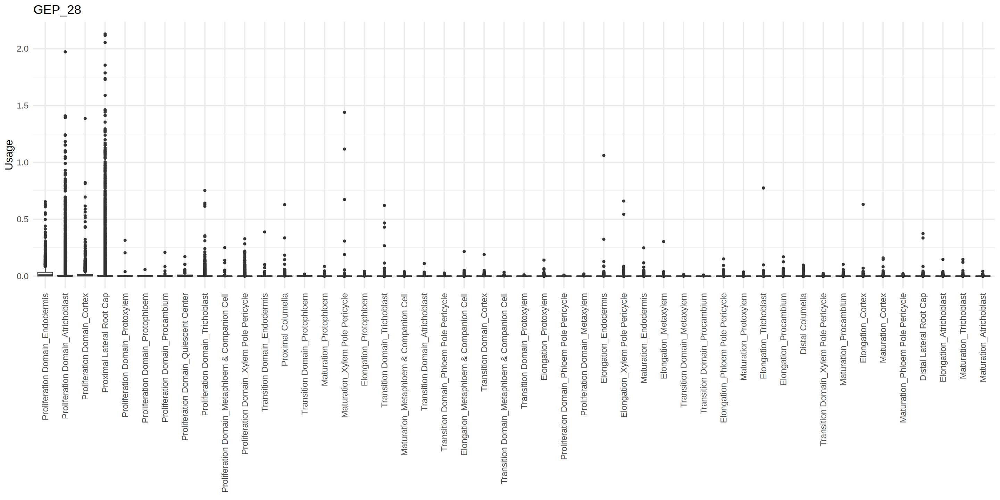

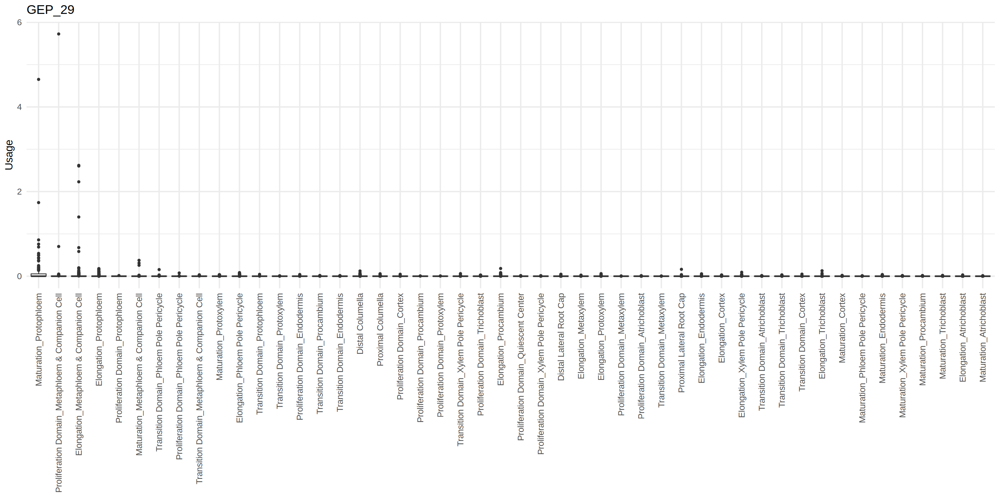

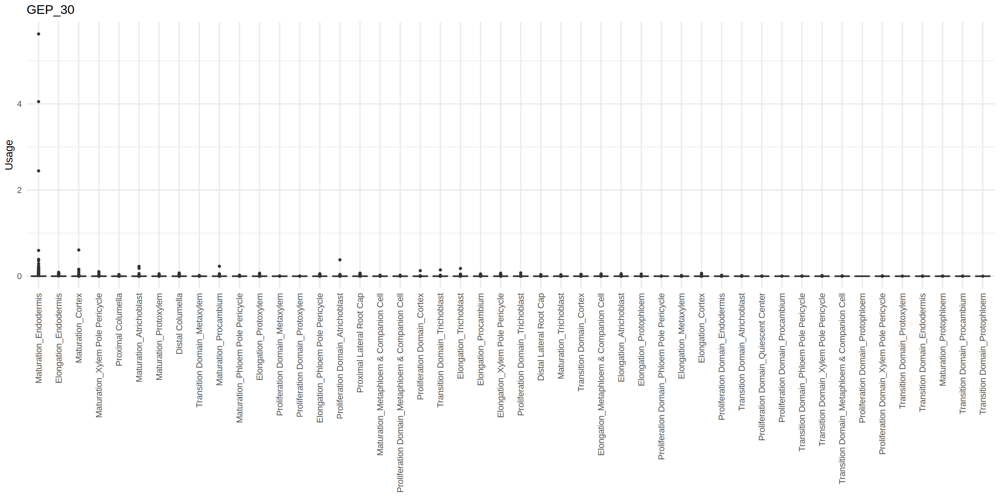

In [45]:
for (i in seq(1,30)){
    plot_box(rc.integrated$time.celltype.anno.Li, GEP_usage[,which(colnames(GEP_usage)==paste0("GEP_",i))], paste0("GEP_",i))
}

In [46]:
plot_feature <- function(feature){
    options(repr.plot.width=6, repr.plot.height=6)
    suppressMessages(print(FeaturePlot(rc.integrated, features = paste0("GEP_",i),pt.size=1.2,raster=FALSE, order = T)+
      scale_colour_gradient(low = "#eeeeee", high = "#ff0000")))
}

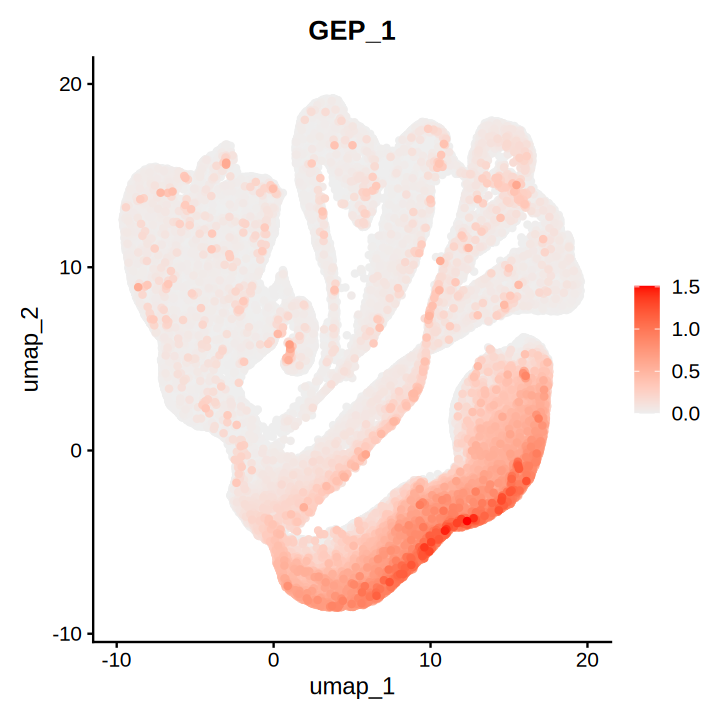

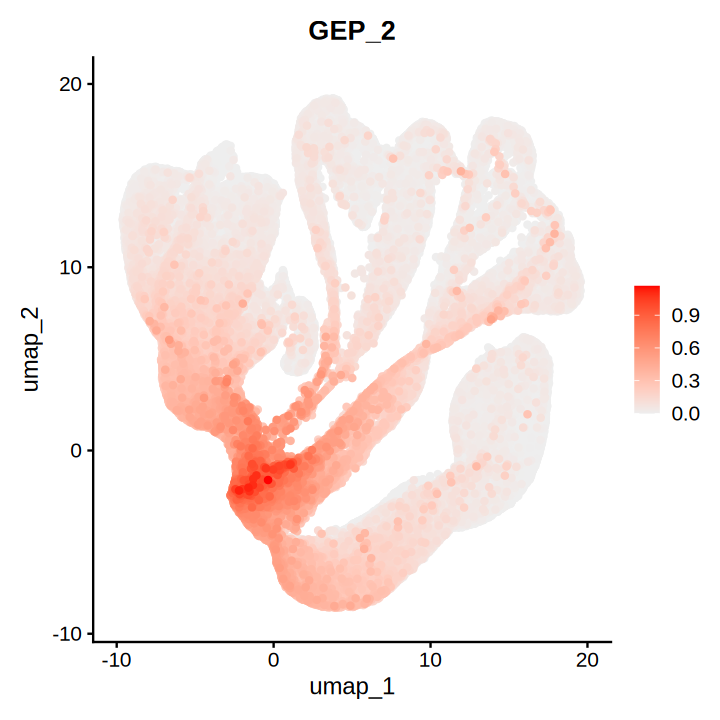

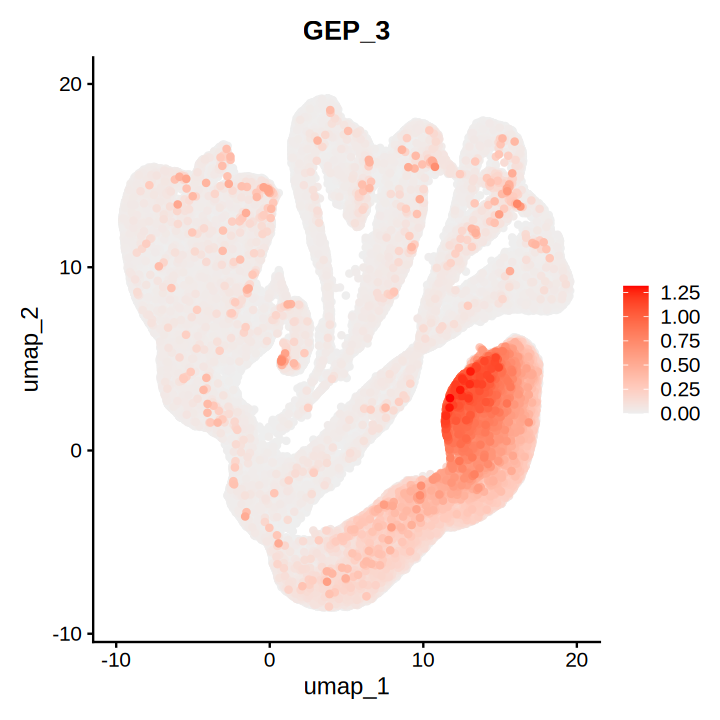

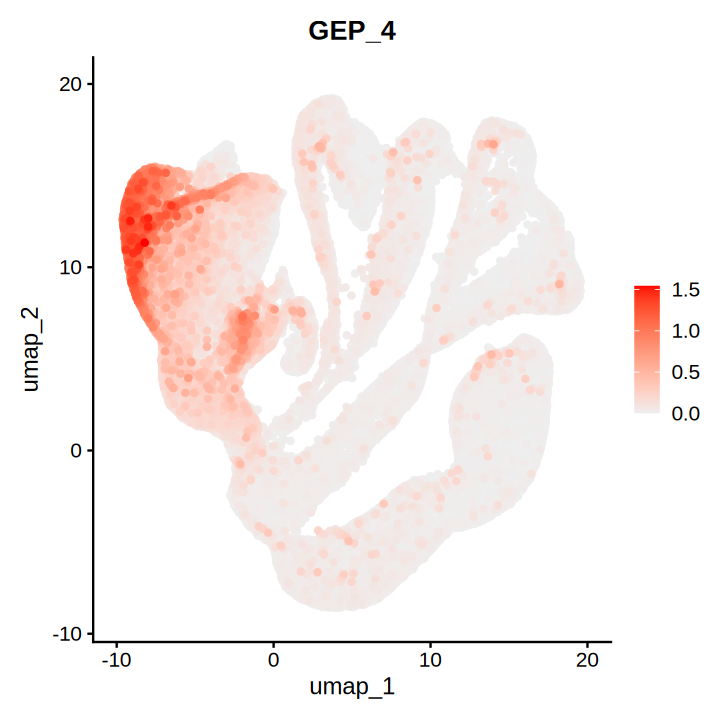

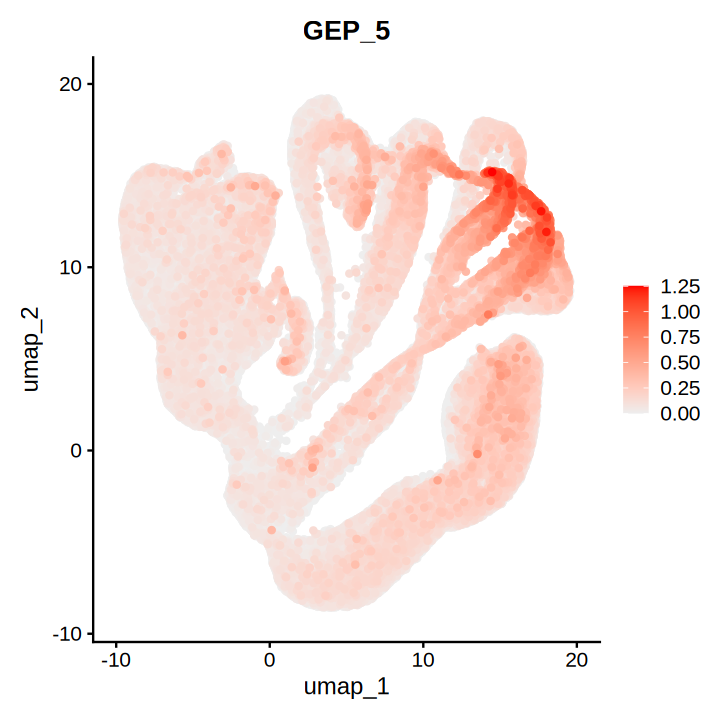

...

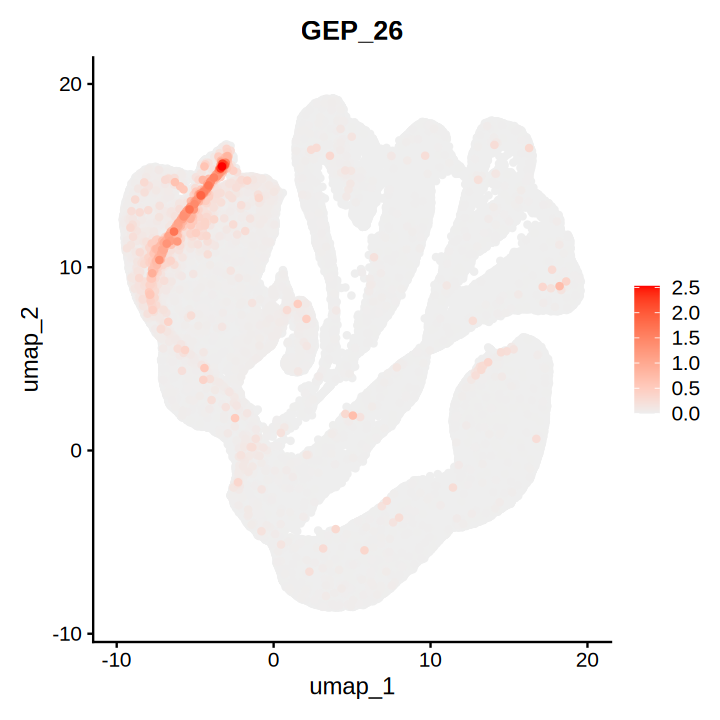

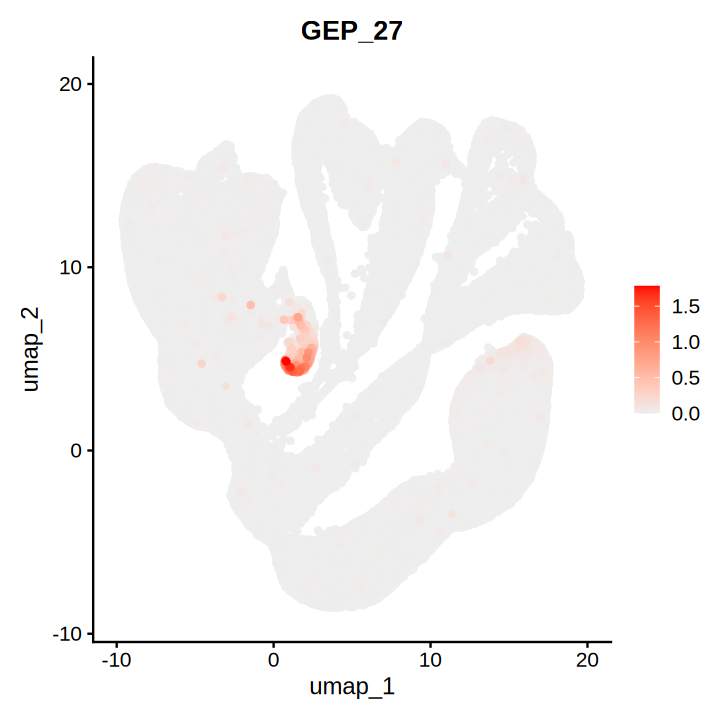

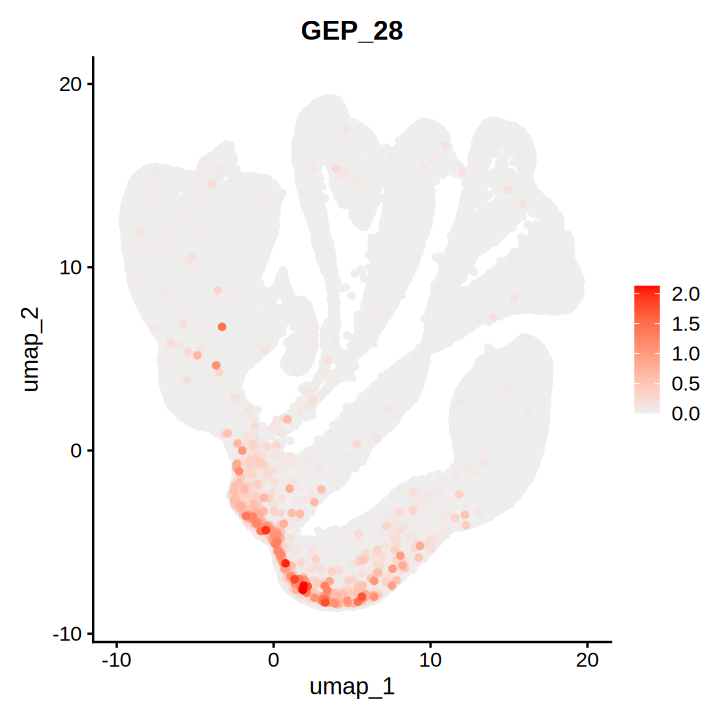

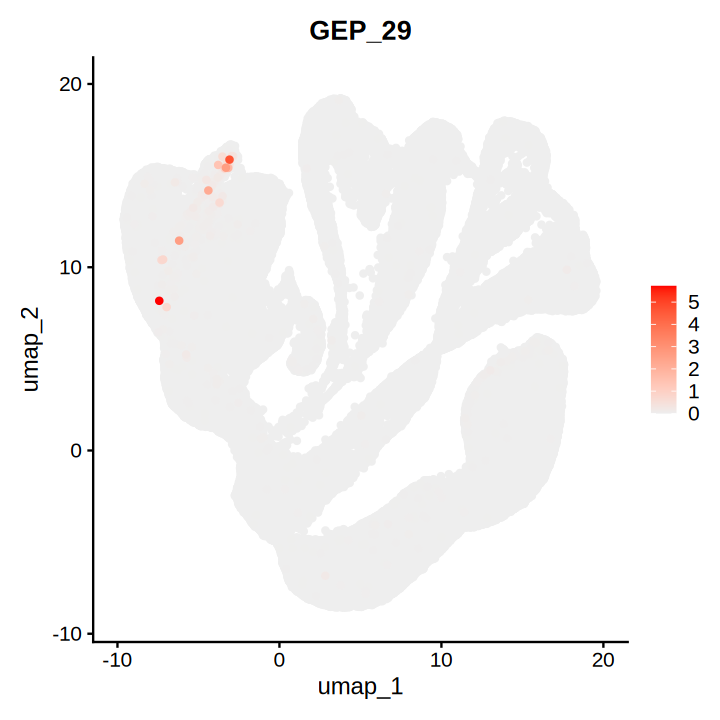

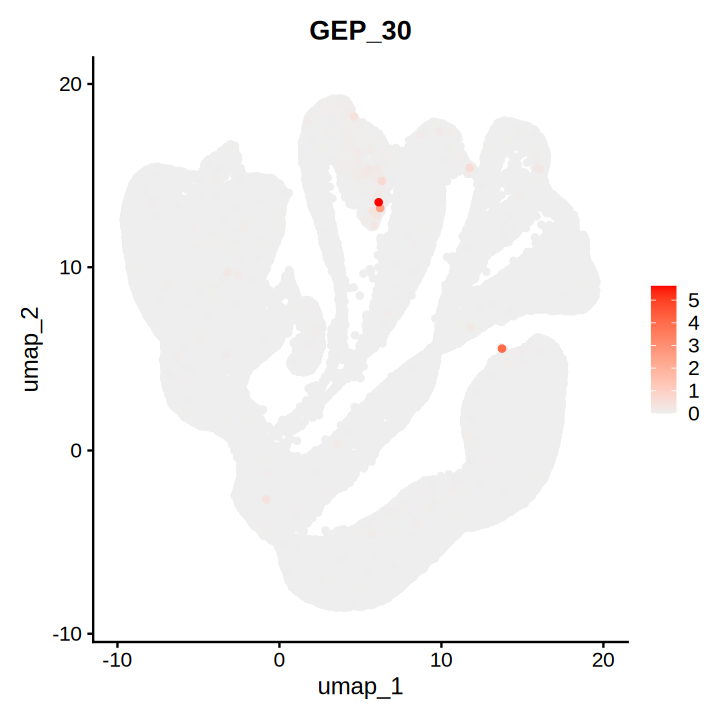

In [47]:
for (i in seq(1,30)){
    plot_feature(i)
}

### Plot heatmaps

In [69]:
meta_df <- rc.integrated@meta.data

In [70]:
head(meta_df)

,orig.ident,nCount_RNA,nFeature_RNA,nCount_spliced_RNA,nFeature_spliced_RNA,nCount_unspliced_RNA,nFeature_unspliced_RNA,percent.mt,percent.cp,nCount_SCT,⋯,GEP_23,GEP_24,GEP_25,GEP_26,GEP_27,GEP_28,GEP_29,GEP_30,time.anno.Li,celltype.anno.Li
,<chr>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
AAACCCAAGCCATTCA_1,sc_12,11727,4244,10032,3899,1695,1027,0.2899292,0.07674597,18223,⋯,0.005426142,0.003614915,0,0.003510636,0.0002423366,0.00000000,0.000000e+00,0.0001246741,Transition Domain,Atrichoblast
AAACCCAAGCTGTTCA_1,sc_12,23585,4301,20531,4064,3054,1123,0.1823193,0.03391986,19971,⋯,0.003494375,0.003057198,0,0.000000000,0.0042506721,0.00000000,1.512234e-05,0.0000000000,Elongation,Atrichoblast
AAACCCAAGGCGAACT_1,sc_12,25828,5211,22837,4885,2991,1339,2.8147747,0.38330494,20252,⋯,0.000000000,0.000000000,0,0.000000000,0.0000000000,0.00000000,0.000000e+00,0.0000000000,Elongation,Cortex
AAACCCACACCAGCCA_1,sc_12,10172,3155,8968,2917,1204,742,1.6220999,0.06881636,18426,⋯,0.000000000,0.001699086,0,0.002404297,0.0038288122,0.00000000,0.000000e+00,0.0000000000,Distal Columella,Columella
AAACCCACACTGGCGT_1,sc_12,7883,2387,7051,2199,832,523,1.5349486,0.15222631,17877,⋯,0.009840735,0.000000000,0,0.000000000,0.0016002835,0.00154616,1.519888e-03,0.0000000000,Distal Columella,Columella
AAACCCACAGACCTGC_1,sc_12,16718,4885,14501,4566,2217,1183,1.3817442,0.11364996,18505,⋯,0.002350374,0.001118176,0,0.000000000,0.0009722757,0.00000000,0.000000e+00,0.0002402171,Proximal Lateral Root Cap,Lateral Root Cap


In [71]:
sel_cols <- colnames(meta_df)[str_detect(colnames(meta_df), pattern = "GEP")]

plot_df <- meta_df %>%
  select(all_of(c("time.celltype.anno.Li", sel_cols))) %>%
  pivot_longer(
    cols = all_of(sel_cols),
    names_to = "GEP",
    values_to = "score"
  )

In [72]:
head(plot_df)

time.celltype.anno.Li,GEP,score
<chr>,<chr>,<dbl>
Transition Domain_Atrichoblast,GEP_1,0.048937132
Transition Domain_Atrichoblast,GEP_2,0.090610156
Transition Domain_Atrichoblast,GEP_3,0.007496949
Transition Domain_Atrichoblast,GEP_4,0.004143808
Transition Domain_Atrichoblast,GEP_5,0.028138386
Transition Domain_Atrichoblast,GEP_6,0.032383663


In [73]:
# Average score per GEP × time.celltype.anno.Li
# complete: Complete a data frame with missing combinations of data
# Since some cell types are missing in some time points, fill in missing combinations with score = 0
agg_df <- plot_df %>%
  group_by(GEP, time.celltype.anno.Li) %>%
  summarize(score = mean(score, na.rm = TRUE), .groups = "drop") %>%
  tidyr::complete(GEP, time.celltype.anno.Li, fill = list(score = 0))  # Fill in missing combinations with 0


In [74]:
head(agg_df)

GEP,time.celltype.anno.Li,score
<chr>,<chr>,<dbl>
GEP_1,Distal Columella,0.116370296
GEP_1,Distal Lateral Root Cap,0.259318081
GEP_1,Elongation_Atrichoblast,0.007209387
GEP_1,Elongation_Cortex,0.003187568
GEP_1,Elongation_Endodermis,0.002586088
GEP_1,Elongation_Metaphloem & Companion Cell,0.004248871


In [75]:
agg_df$GEP <- factor(agg_df$GEP, levels = paste0("GEP_", 1:n_distinct(agg_df$GEP)))

In [76]:
levels(agg_df$GEP )

[1] "GEP_1"  "GEP_2"  "GEP_3"  "GEP_4"  "GEP_5"  "GEP_6"  "GEP_7"  "GEP_8" 
 [9] "GEP_9"  "GEP_10" "GEP_11" "GEP_12" "GEP_13" "GEP_14" "GEP_15" "GEP_16"
[17] "GEP_17" "GEP_18" "GEP_19" "GEP_20" "GEP_21" "GEP_22" "GEP_23" "GEP_24"
[25] "GEP_25" "GEP_26" "GEP_27" "GEP_28" "GEP_29" "GEP_30"

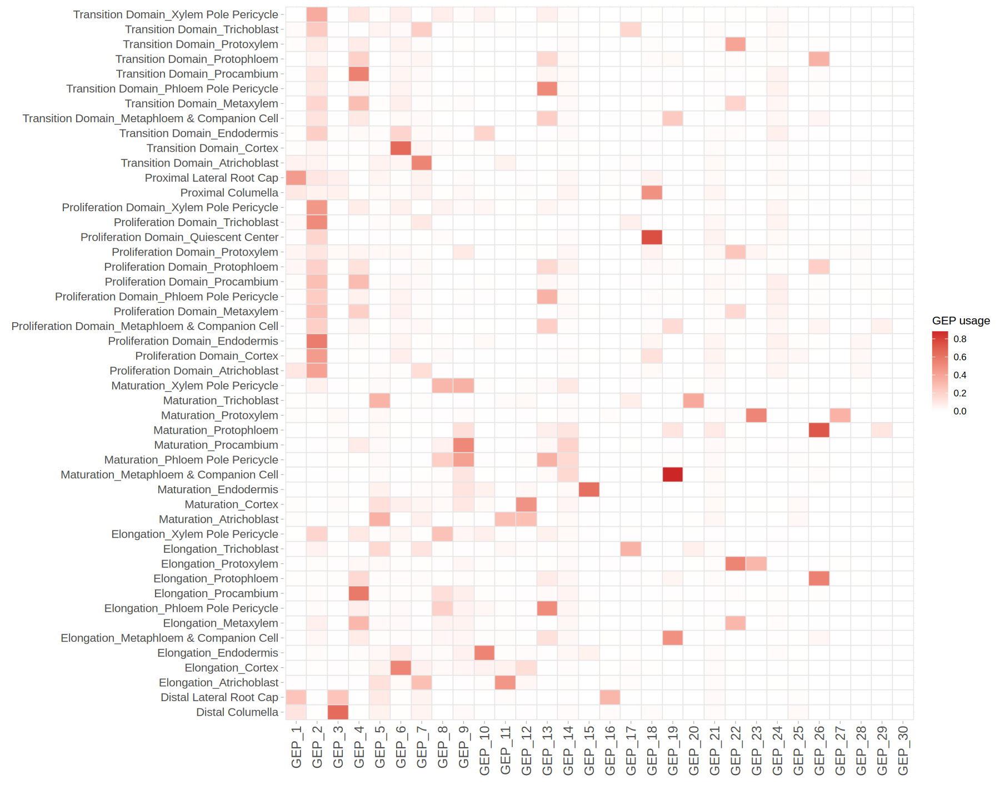

In [79]:
options(repr.plot.width = 15, repr.plot.height = 12)

ggplot(agg_df, aes(y = time.celltype.anno.Li, x = GEP, fill = score)) +
  geom_tile(color = "grey90", size = 0.3) +
  scale_fill_gradient2(low = "white", high = "firebrick3", name = "GEP usage") +
  theme_light(base_size = 12) +
  theme(
    strip.placement = "outside",
    axis.title.x = element_text(margin = margin(t = 10)),
    axis.text.x = element_text(angle = 90, hjust = 1, vjust = 0.5, size = 14),
    axis.text.y = element_text(size = 12),
    panel.grid.major = element_line(color = "grey90", linewidth = 0.1),
    panel.grid.minor = element_blank(),
    panel.border = element_blank(),
    strip.background = element_rect(fill = "darkgrey"),
    strip.text = element_text(color = "white", face = "bold")
  ) +
  labs(
    x = "",
    y = ""
  )


## GEPs specificity on cell cycle phases

In [43]:
rc.integrated_tricycle <- readRDS("/resnick/groups/NolanLab/shared_resources/annotated_objects/rds/integrated/Root_Atlas_v2_seu4_20230907_tricycle.rds")



In [49]:
plot_box <- function(annotation, value, title){
    # Prepare data
data <- data.frame(
  annotation = annotation,
  value = value
)

#Prepare mean values for each annotation and reorder
data <- data %>%
  group_by(annotation) %>%
  mutate(mean_value = mean(value)) %>%
  ungroup() %>%
  mutate(annotation = reorder(annotation, desc(mean_value)))
    
  options(repr.plot.width=8, repr.plot.height=6)
  # Create the boxplot
  print(ggplot(data, aes(x = annotation, y = value)) +
  geom_boxplot() +
  labs(x = "", y = "Usage", title = title) +
  theme_minimal(base_size=18) +
  theme(axis.text.x = element_text(angle = 90, hjust = 1, vjust = 0.5)) )
    
}

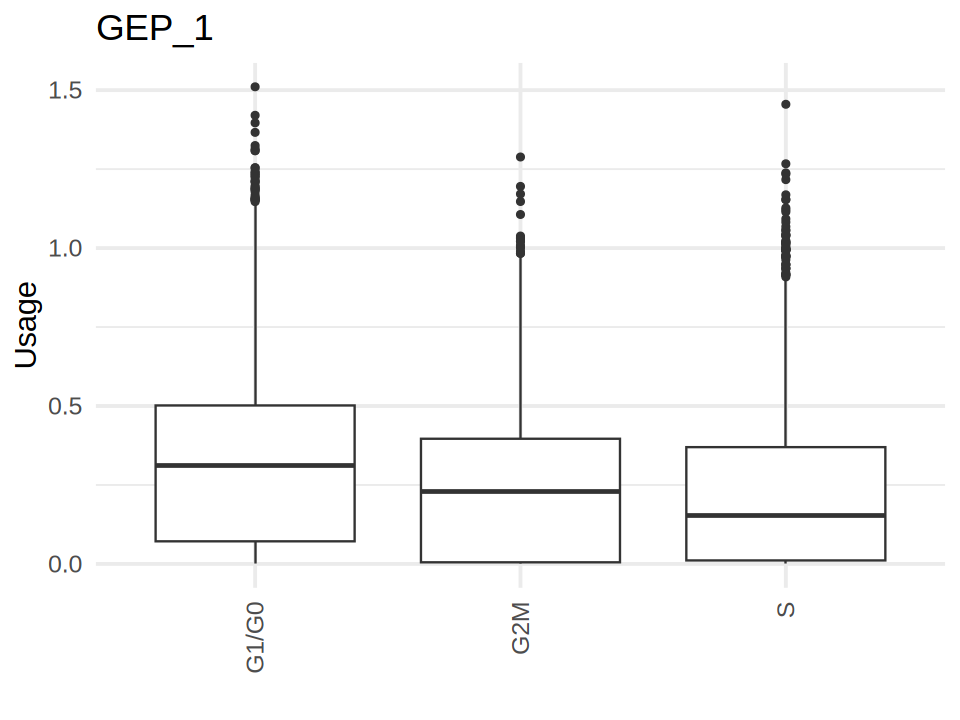

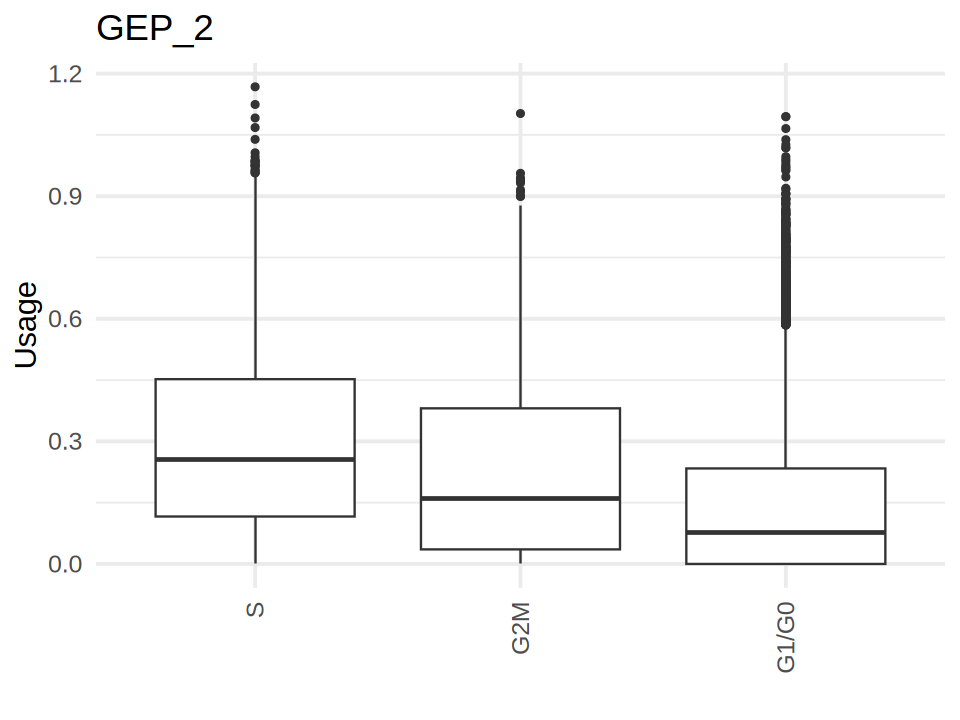

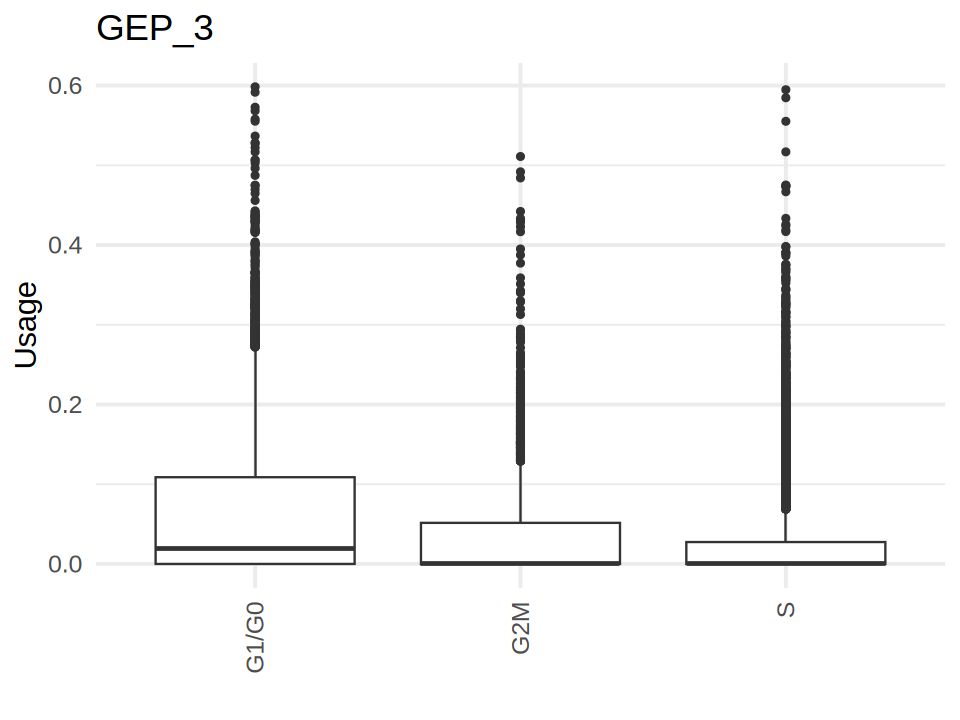

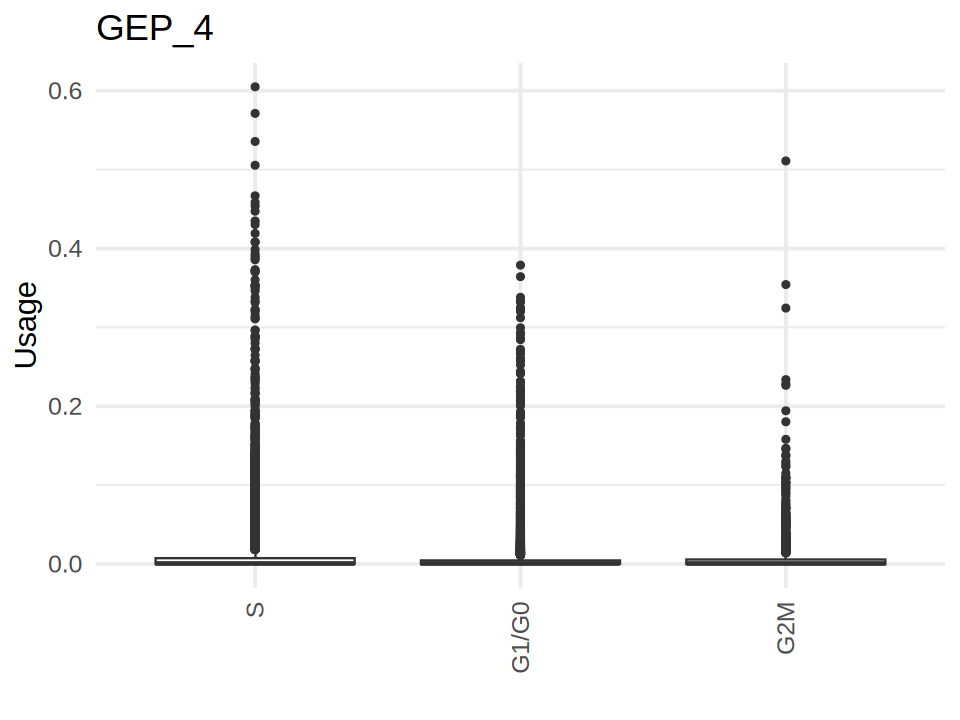

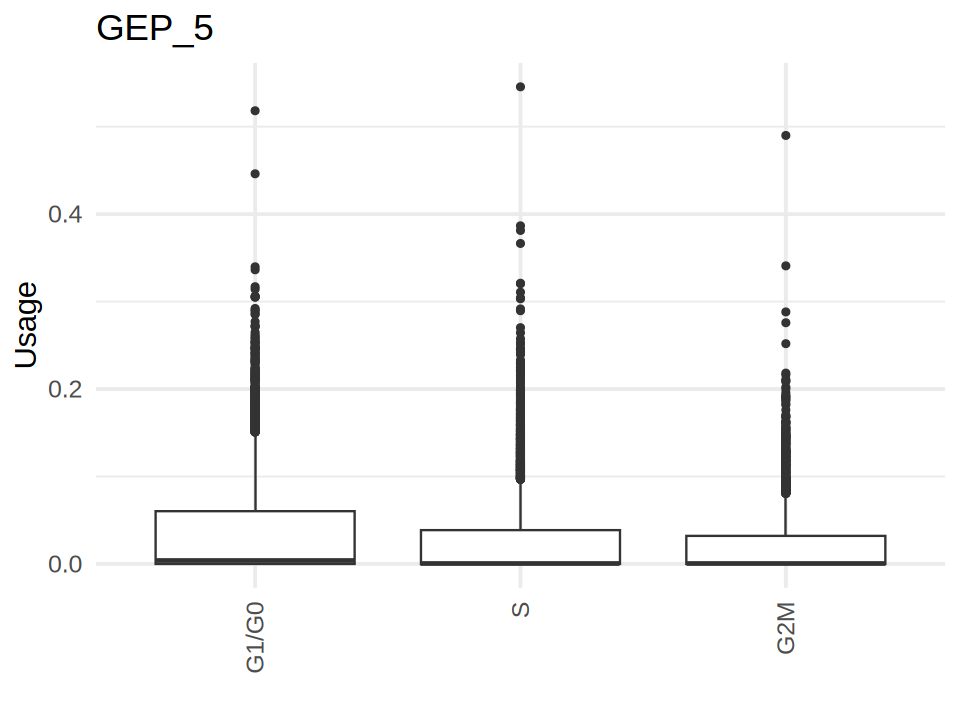

...

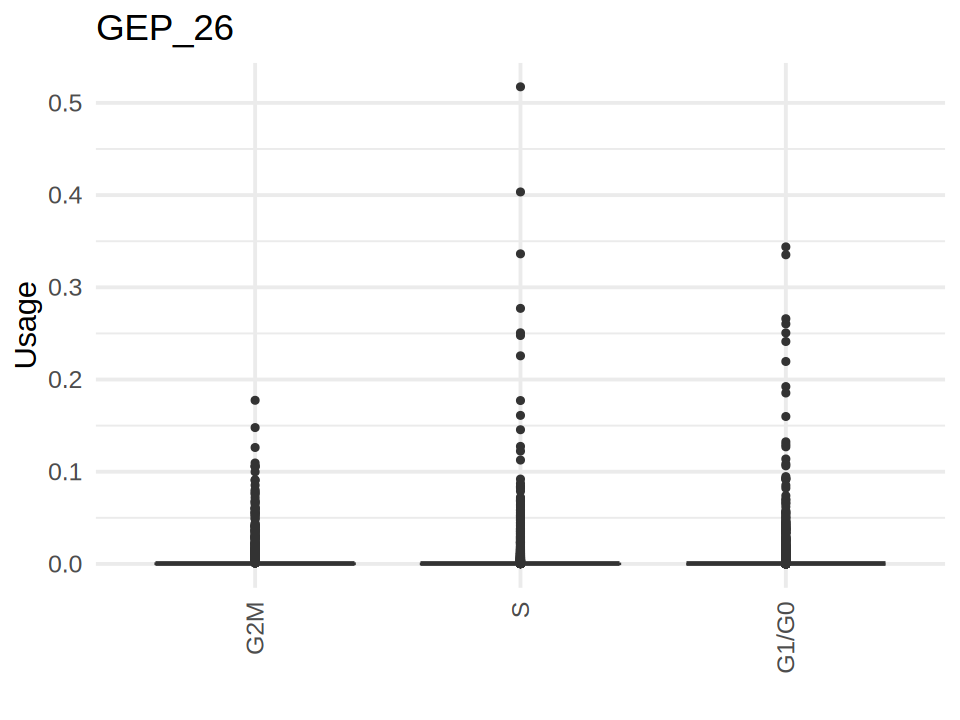

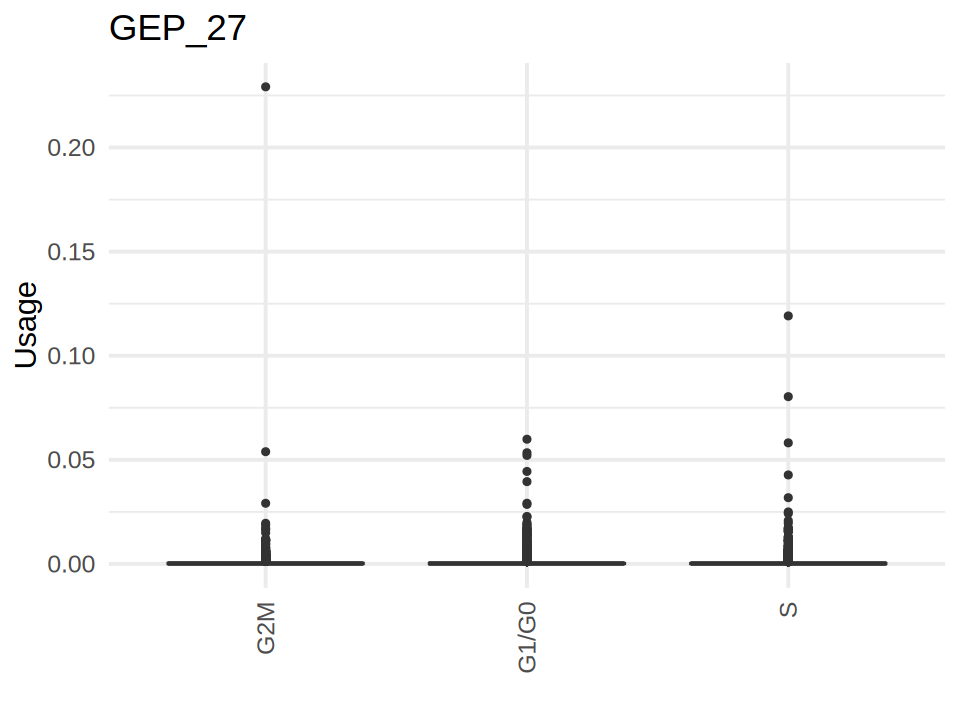

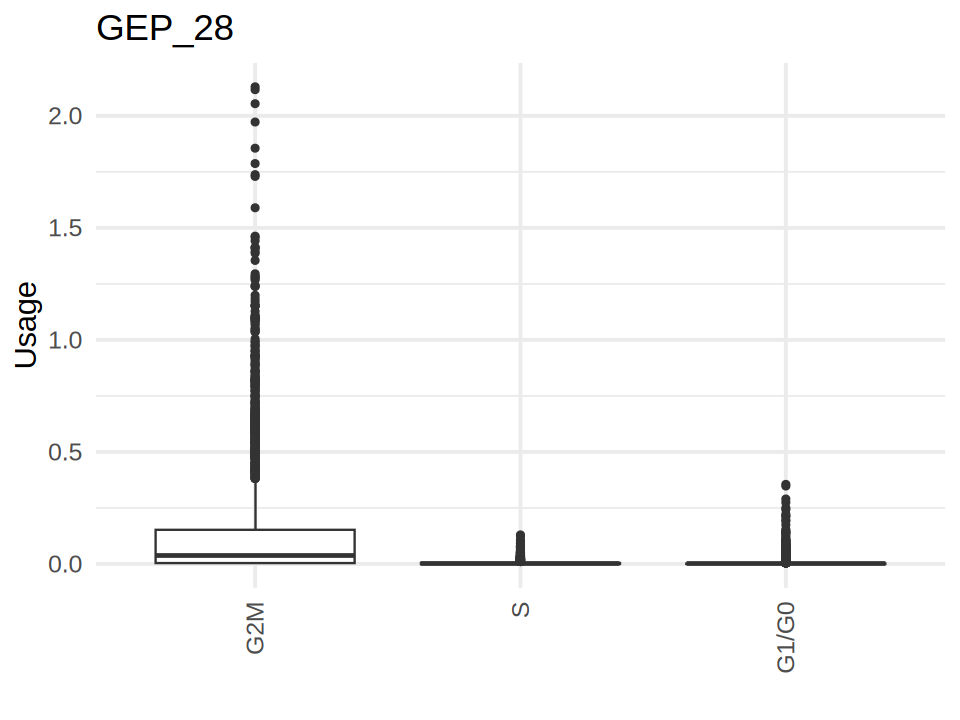

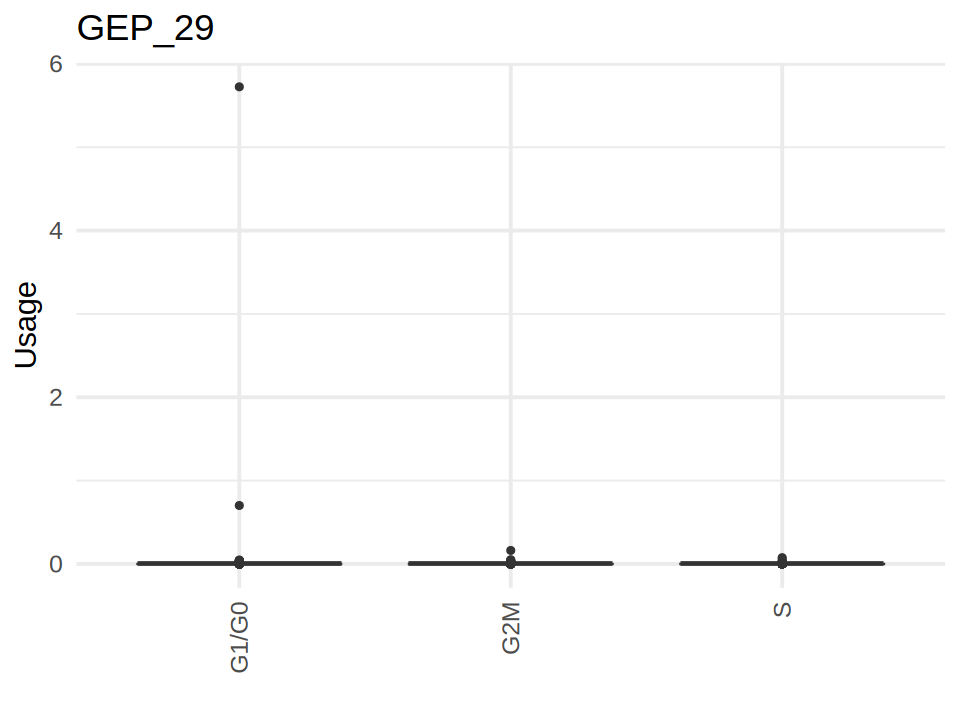

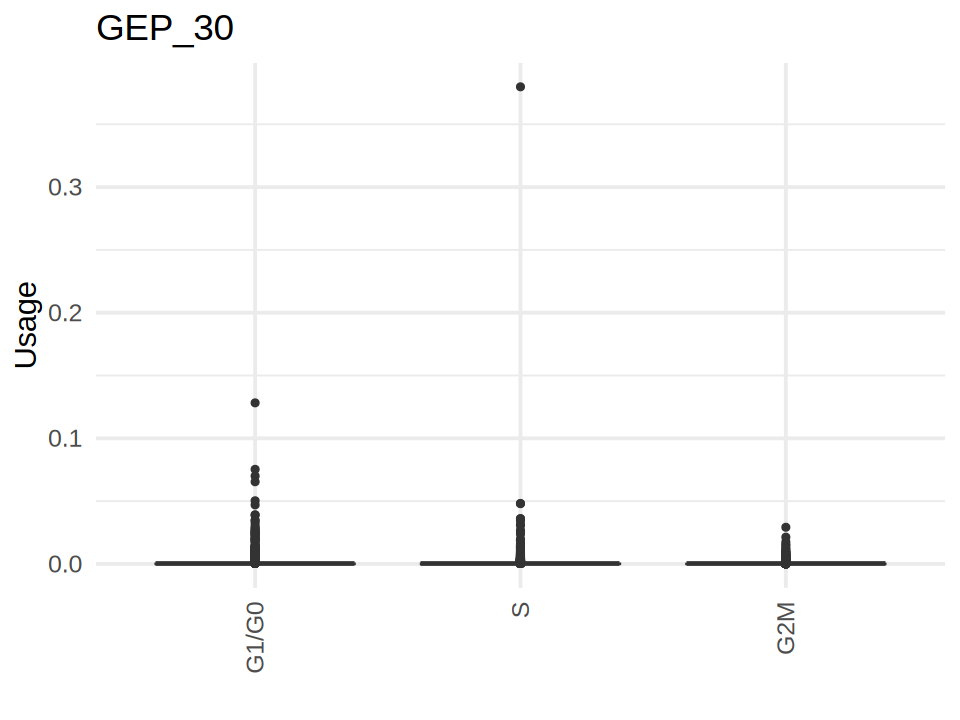

In [50]:
for (i in seq(1,30)){
    plot_box(rc.integrated_tricycle$tricycleCCStage[which(rc.integrated_tricycle$time.anno.Li=="Proliferation Domain" |
                                                          rc.integrated_tricycle$time.anno.Li=="Proximal Lateral Root Cap" | 
                                                          rc.integrated_tricycle$time.anno.Li=="Proximal Columella")], 
             GEP_usage[,which(colnames(GEP_usage)==paste0("GEP_",i))][which(rc.integrated_tricycle$time.anno.Li=="Proliferation Domain" | 
                                                                            rc.integrated_tricycle$time.anno.Li=="Proximal Lateral Root Cap" | 
                                                                            rc.integrated_tricycle$time.anno.Li=="Proximal Columella")],
             paste0("GEP_",i))
}

### Plot heatmaps

In [44]:
# Check if the order of cell barcodes are the same
identical(GEP_usage$cell_barcode, colnames(rc.integrated_tricycle))


[1] TRUE

In [45]:
GEP_usage$cell_barcode[1]
colnames(rc.integrated_tricycle)[1]

[1] "AAACCCAAGCCATTCA_1"

[1] "AAACCCAAGCCATTCA_1"

In [46]:
# Update metadata
rc.integrated_tricycle$GEP_1 <- GEP_usage$GEP_1
rc.integrated_tricycle$GEP_2 <- GEP_usage$GEP_2
rc.integrated_tricycle$GEP_3 <- GEP_usage$GEP_3
rc.integrated_tricycle$GEP_4 <- GEP_usage$GEP_4
rc.integrated_tricycle$GEP_5 <- GEP_usage$GEP_5
rc.integrated_tricycle$GEP_6 <- GEP_usage$GEP_6
rc.integrated_tricycle$GEP_7 <- GEP_usage$GEP_7
rc.integrated_tricycle$GEP_8 <- GEP_usage$GEP_8
rc.integrated_tricycle$GEP_9 <- GEP_usage$GEP_9
rc.integrated_tricycle$GEP_10 <- GEP_usage$GEP_10
rc.integrated_tricycle$GEP_11 <- GEP_usage$GEP_11
rc.integrated_tricycle$GEP_12 <- GEP_usage$GEP_12
rc.integrated_tricycle$GEP_13 <- GEP_usage$GEP_13
rc.integrated_tricycle$GEP_14 <- GEP_usage$GEP_14
rc.integrated_tricycle$GEP_15 <- GEP_usage$GEP_15
rc.integrated_tricycle$GEP_16 <- GEP_usage$GEP_16
rc.integrated_tricycle$GEP_17 <- GEP_usage$GEP_17
rc.integrated_tricycle$GEP_18 <- GEP_usage$GEP_18
rc.integrated_tricycle$GEP_19 <- GEP_usage$GEP_19
rc.integrated_tricycle$GEP_20 <- GEP_usage$GEP_20
rc.integrated_tricycle$GEP_21 <- GEP_usage$GEP_21
rc.integrated_tricycle$GEP_22 <- GEP_usage$GEP_22
rc.integrated_tricycle$GEP_23 <- GEP_usage$GEP_23
rc.integrated_tricycle$GEP_24 <- GEP_usage$GEP_24
rc.integrated_tricycle$GEP_25 <- GEP_usage$GEP_25
rc.integrated_tricycle$GEP_26 <- GEP_usage$GEP_26
rc.integrated_tricycle$GEP_27 <- GEP_usage$GEP_27
rc.integrated_tricycle$GEP_28 <- GEP_usage$GEP_28
rc.integrated_tricycle$GEP_29 <- GEP_usage$GEP_29
rc.integrated_tricycle$GEP_30 <- GEP_usage$GEP_30


In [47]:
meta_df_tricycle <- rc.integrated_tricycle@meta.data

In [48]:
head(meta_df_tricycle)

,orig.ident,nCount_RNA,nFeature_RNA,nCount_spliced_RNA,nFeature_spliced_RNA,nCount_unspliced_RNA,nFeature_unspliced_RNA,percent.mt,percent.cp,nCount_SCT,⋯,GEP_21,GEP_22,GEP_23,GEP_24,GEP_25,GEP_26,GEP_27,GEP_28,GEP_29,GEP_30
,<chr>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AAACCCAAGCCATTCA_1,sc_12,11727,4244,10032,3899,1695,1027,0.2899292,0.07674597,18223,⋯,0.000000000,0.003786700,0.005426142,0.003614915,0,0.003510636,0.0002423366,0.00000000,0.000000e+00,0.0001246741
AAACCCAAGCTGTTCA_1,sc_12,23585,4301,20531,4064,3054,1123,0.1823193,0.03391986,19971,⋯,0.000000000,0.000000000,0.003494375,0.003057198,0,0.000000000,0.0042506721,0.00000000,1.512234e-05,0.0000000000
AAACCCAAGGCGAACT_1,sc_12,25828,5211,22837,4885,2991,1339,2.8147747,0.38330494,20252,⋯,0.000000000,0.000000000,0.000000000,0.000000000,0,0.000000000,0.0000000000,0.00000000,0.000000e+00,0.0000000000
AAACCCACACCAGCCA_1,sc_12,10172,3155,8968,2917,1204,742,1.6220999,0.06881636,18426,⋯,0.008774841,0.011675368,0.000000000,0.001699086,0,0.002404297,0.0038288122,0.00000000,0.000000e+00,0.0000000000
AAACCCACACTGGCGT_1,sc_12,7883,2387,7051,2199,832,523,1.5349486,0.15222631,17877,⋯,0.000000000,0.002467955,0.009840735,0.000000000,0,0.000000000,0.0016002835,0.00154616,1.519888e-03,0.0000000000
AAACCCACAGACCTGC_1,sc_12,16718,4885,14501,4566,2217,1183,1.3817442,0.11364996,18505,⋯,0.000000000,0.000000000,0.002350374,0.001118176,0,0.000000000,0.0009722757,0.00000000,0.000000e+00,0.0002402171


In [50]:
meta_df_tricycle_fil <- meta_df_tricycle %>%
   filter(time.anno.Li %in% c("Proliferation Domain", "Proximal Lateral Root Cap", "Proximal Columella"))

In [51]:
head(meta_df_tricycle_fil, 3)

,orig.ident,nCount_RNA,nFeature_RNA,nCount_spliced_RNA,nFeature_spliced_RNA,nCount_unspliced_RNA,nFeature_unspliced_RNA,percent.mt,percent.cp,nCount_SCT,⋯,GEP_21,GEP_22,GEP_23,GEP_24,GEP_25,GEP_26,GEP_27,GEP_28,GEP_29,GEP_30
,<chr>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AAACCCACAGACCTGC_1,sc_12,16718,4885,14501,4566,2217,1183,1.3817442,0.11364996,18505,⋯,0.000000000,0.000000000,0.0023503739,0.0011181757,0,0.0000000000,0.0009722757,0,0,0.0002402171
AAACCCAGTCCACAGC_1,sc_12,16626,4661,14425,4387,2201,1102,0.8600986,0.07217611,18517,⋯,0.001941484,0.001127956,0.0001799562,0.0000000000,0,0.0000000000,0.0000000000,0,0,0.0000000000
AAACCCAGTTAGAAGT_1,sc_12,11400,3549,10102,3324,1298,755,0.7192982,0.02631579,18327,⋯,0.000000000,0.004755076,0.0010940369,0.0002166542,0,0.0001418905,0.0018345732,0,0,0.0000000000


In [52]:
unique(meta_df_tricycle_fil$time.anno.Li)

[1] "Proximal Lateral Root Cap" "Proliferation Domain"     
[3] "Proximal Columella"

In [53]:
sel_cols <- colnames(meta_df_tricycle_fil)[str_detect(colnames(meta_df_tricycle_fil), pattern = "GEP")]
sel_cols

[1] "GEP_1"  "GEP_2"  "GEP_3"  "GEP_4"  "GEP_5"  "GEP_6"  "GEP_7"  "GEP_8" 
 [9] "GEP_9"  "GEP_10" "GEP_11" "GEP_12" "GEP_13" "GEP_14" "GEP_15" "GEP_16"
[17] "GEP_17" "GEP_18" "GEP_19" "GEP_20" "GEP_21" "GEP_22" "GEP_23" "GEP_24"
[25] "GEP_25" "GEP_26" "GEP_27" "GEP_28" "GEP_29" "GEP_30"

In [54]:
plot_df_tri_fil <- meta_df_tricycle_fil %>%
  select(all_of(c("tricycleCCStage", sel_cols))) %>%
  pivot_longer(
    cols = all_of(sel_cols),
    names_to = "GEP",
    values_to = "score"
  )

In [55]:
head(plot_df_tri_fil)

tricycleCCStage,GEP,score
<chr>,<chr>,<dbl>
S,GEP_1,0.40810441
S,GEP_2,0.14890155
S,GEP_3,0.10343562
S,GEP_4,0.00000000
S,GEP_5,0.07170737
S,GEP_6,0.00000000


In [56]:
# Average score per GEP × time.celltype.anno.Li
# complete: Complete a data frame with missing combinations of data
# Since some cell types are missing in some time points, fill in missing combinations with score = 0
agg_df_tri_fil <- plot_df_tri_fil %>%
  group_by(GEP, tricycleCCStage) %>%
  summarize(score = mean(score, na.rm = TRUE), .groups = "drop") %>%
  tidyr::complete(GEP, tricycleCCStage, fill = list(score = 0))  # Fill in missing combinations with 0


In [57]:
head(agg_df_tri_fil)

GEP,tricycleCCStage,score
<chr>,<chr>,<dbl>
GEP_1,G1/G0,0.325740789
GEP_1,G2M,0.247927355
GEP_1,S,0.215377646
GEP_10,G1/G0,0.005299042
GEP_10,G2M,0.003848055
GEP_10,S,0.006379374


In [58]:
agg_df_tri_fil$GEP <- factor(agg_df_tri_fil$GEP, levels = paste0("GEP_", 1:n_distinct(agg_df_tri_fil$GEP)))

In [59]:
levels(agg_df_tri_fil$GEP )

[1] "GEP_1"  "GEP_2"  "GEP_3"  "GEP_4"  "GEP_5"  "GEP_6"  "GEP_7"  "GEP_8" 
 [9] "GEP_9"  "GEP_10" "GEP_11" "GEP_12" "GEP_13" "GEP_14" "GEP_15" "GEP_16"
[17] "GEP_17" "GEP_18" "GEP_19" "GEP_20" "GEP_21" "GEP_22" "GEP_23" "GEP_24"
[25] "GEP_25" "GEP_26" "GEP_27" "GEP_28" "GEP_29" "GEP_30"

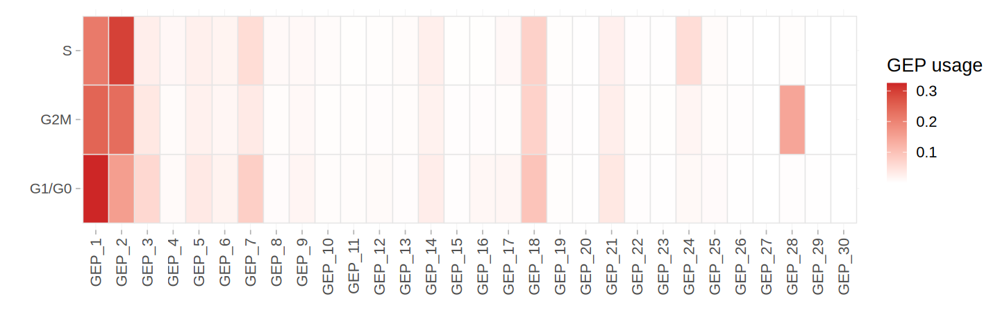

In [67]:
options(repr.plot.width = 12, repr.plot.height = 4)

ggplot(agg_df_tri_fil, aes(y = tricycleCCStage, x = GEP, fill = score)) +
  geom_tile(color = "grey90", size = 0.3) +
  scale_fill_gradient2(low = "white", high = "firebrick3", name = "GEP usage") +
  theme_light(base_size = 16) +
  theme(
    strip.placement = "outside",
    axis.title.x = element_text(margin = margin(t = 10)),
    axis.text.x = element_text(angle = 90, hjust = 1, vjust = 0.5),
    axis.text.y = element_text(size = 12),
    panel.grid.major = element_line(color = "grey90", linewidth = 0.1),
    panel.grid.minor = element_blank(),
    panel.border = element_blank(),
    strip.background = element_rect(fill = "darkgrey"),
    strip.text = element_text(color = "white", face = "bold")
  ) +
  labs(
    x = "",
    y = ""
  )


## GEPs specificity on branches

In [51]:
plot_box <- function(annotation, value, title){
    # Prepare data
data <- data.frame(
  annotation = annotation,
  value = value
)

#Prepare mean values for each annotation and reorder
data <- data %>%
  group_by(annotation) %>%
  mutate(mean_value = mean(value)) %>%
  ungroup() %>%
  mutate(annotation = reorder(annotation, desc(mean_value)))
    
  options(repr.plot.width=8, repr.plot.height=6)
  # Create the boxplot
  print(ggplot(data, aes(x = annotation, y = value)) +
  geom_boxplot() +
  labs(x = "", y = "Usage", title = title) +
  theme_minimal(base_size=18) +
  theme(axis.text.x = element_text(angle = 90, hjust = 1, vjust = 0.5)) )
    
}

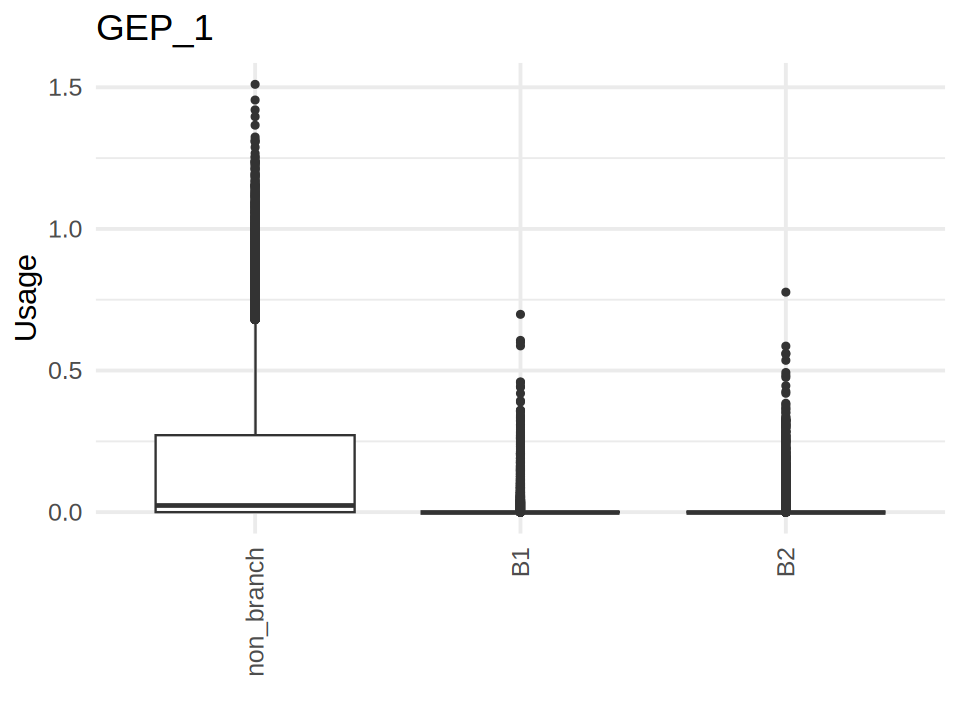

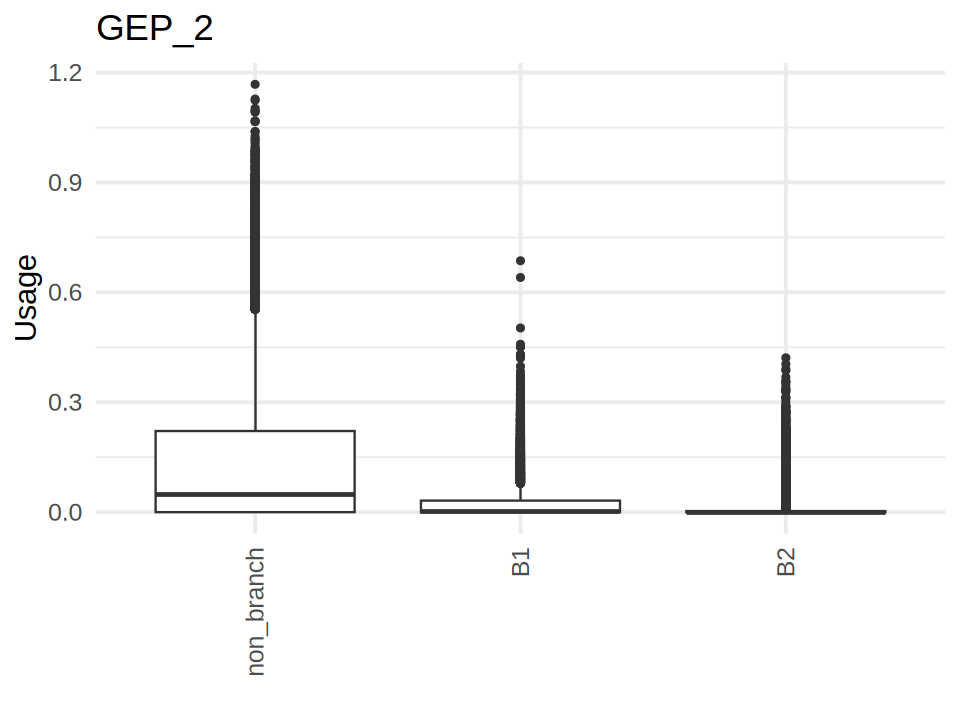

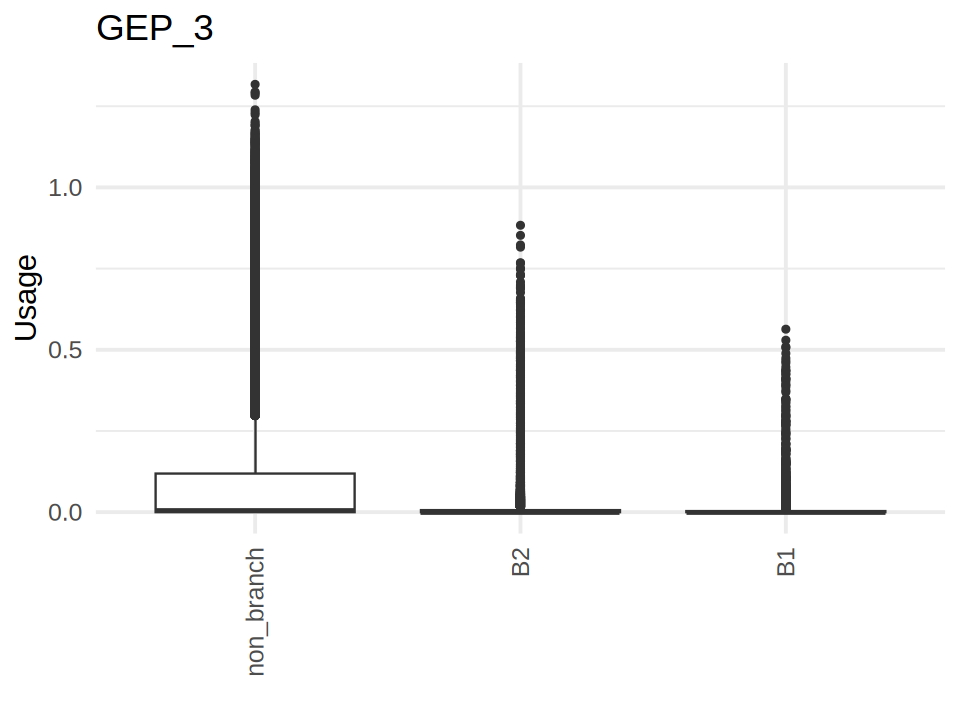

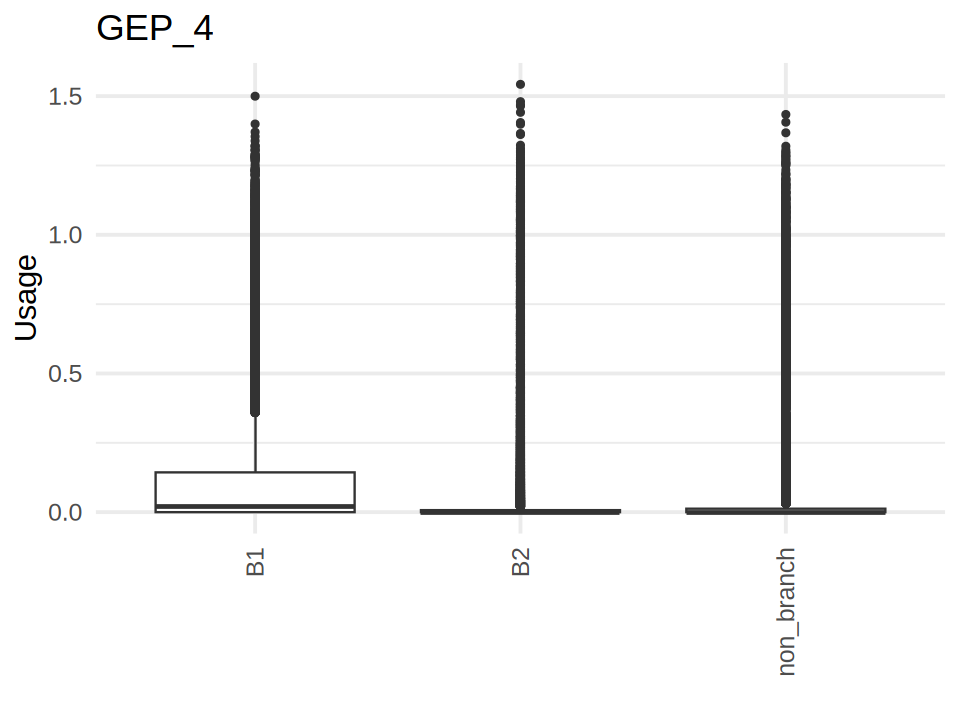

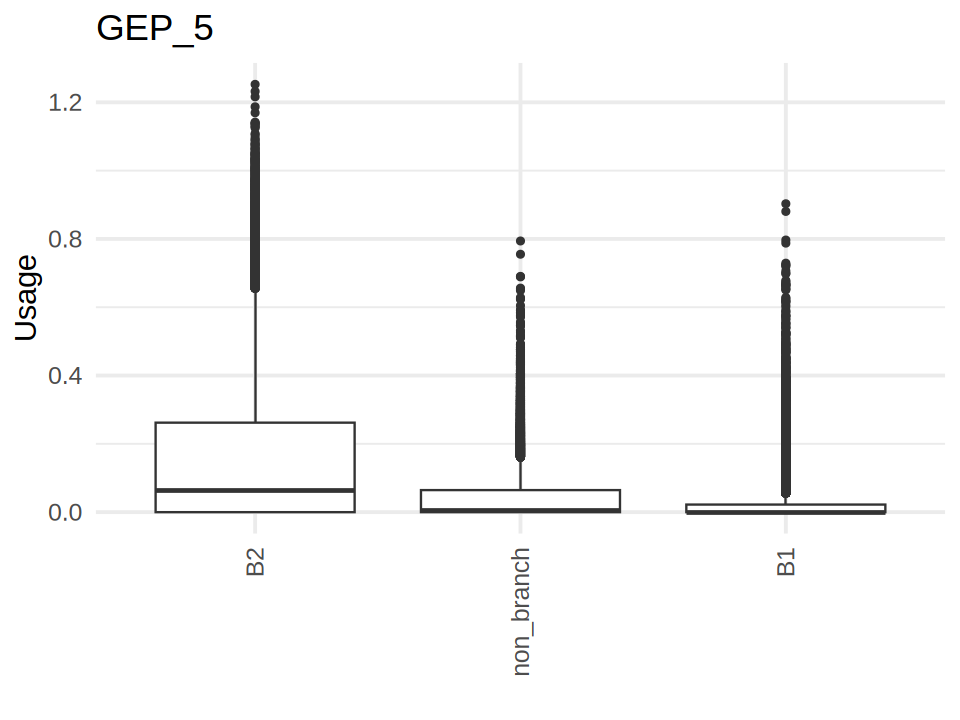

...

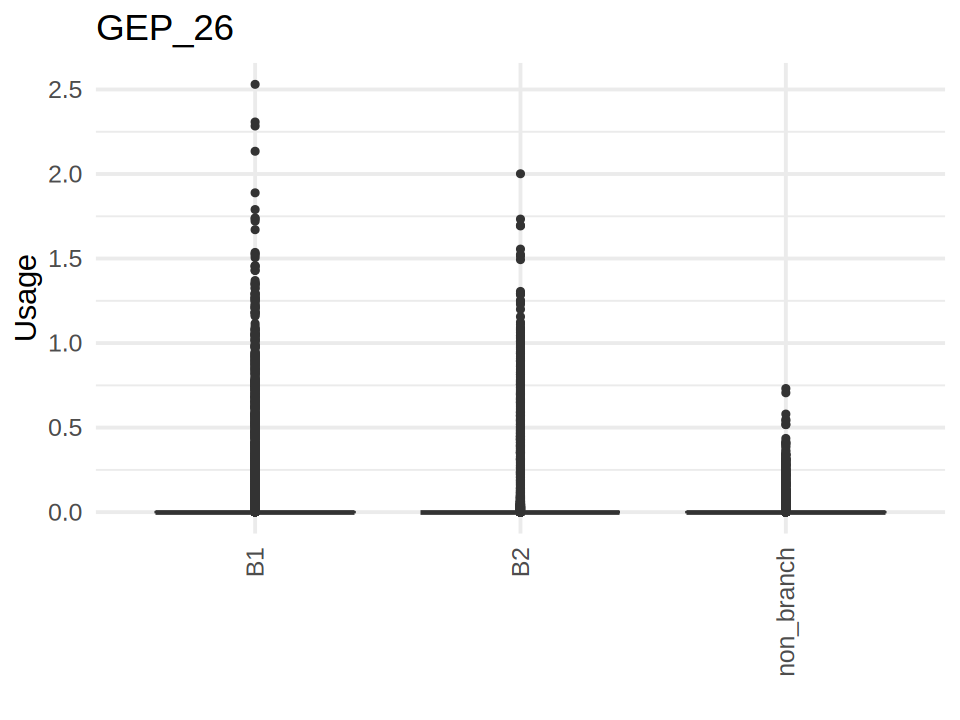

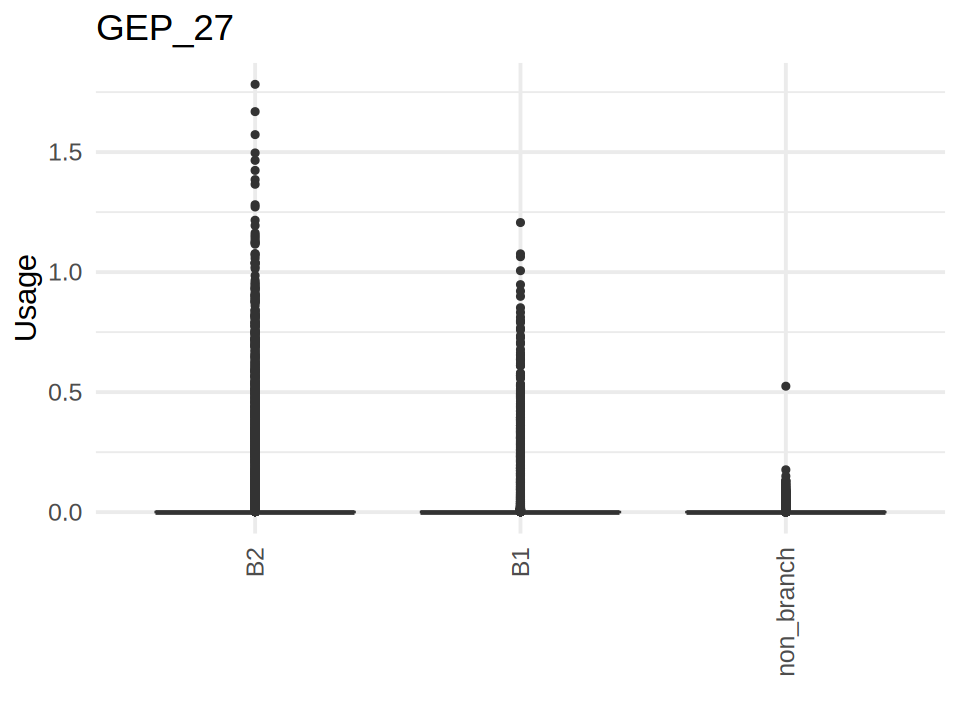

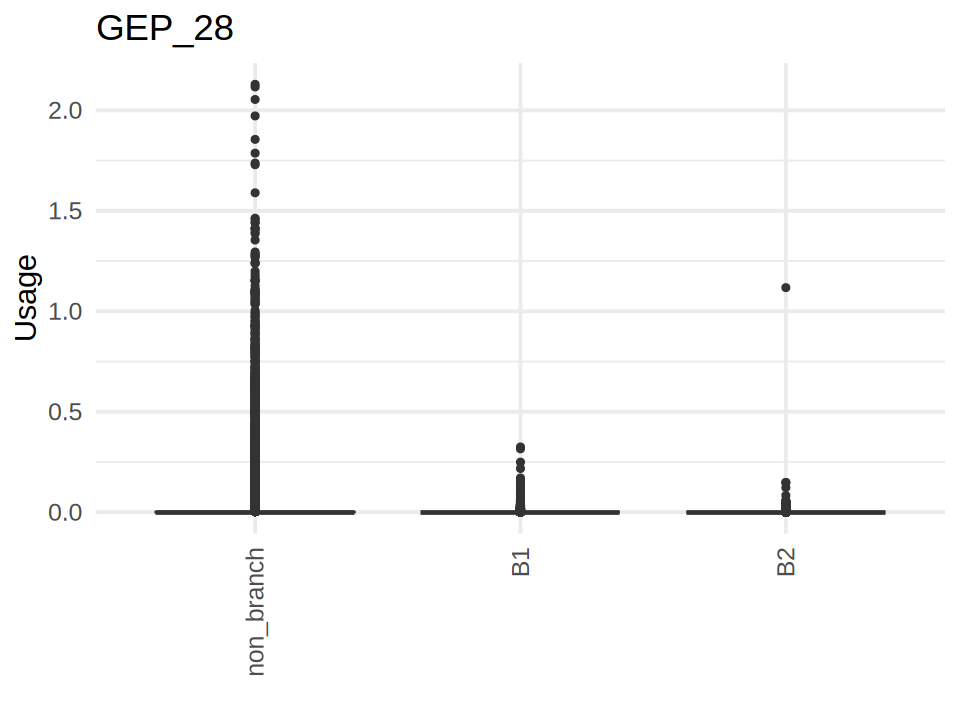

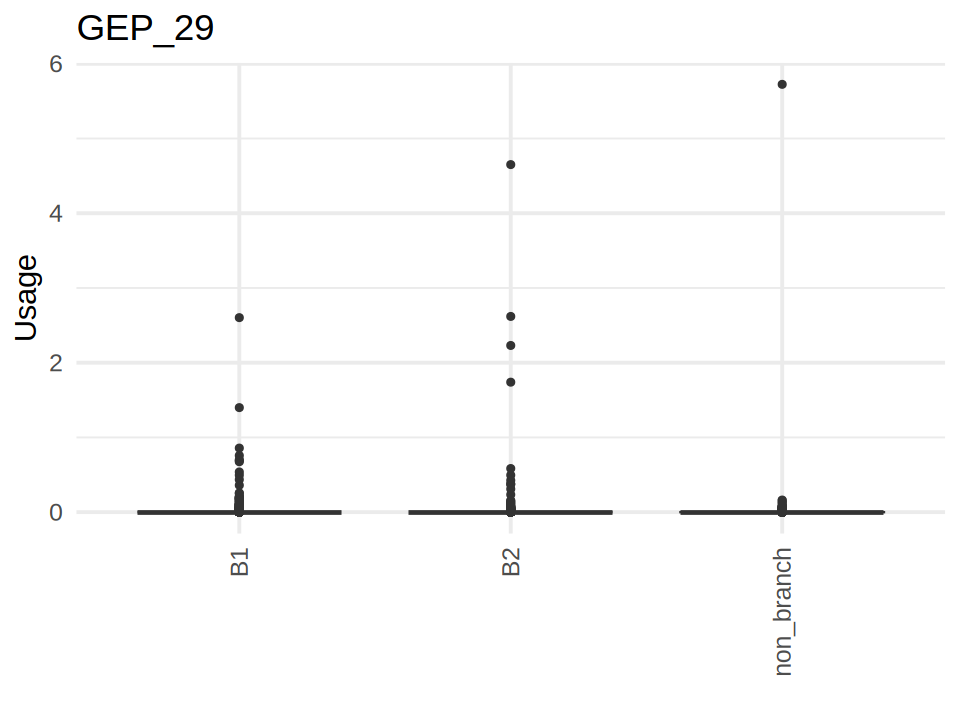

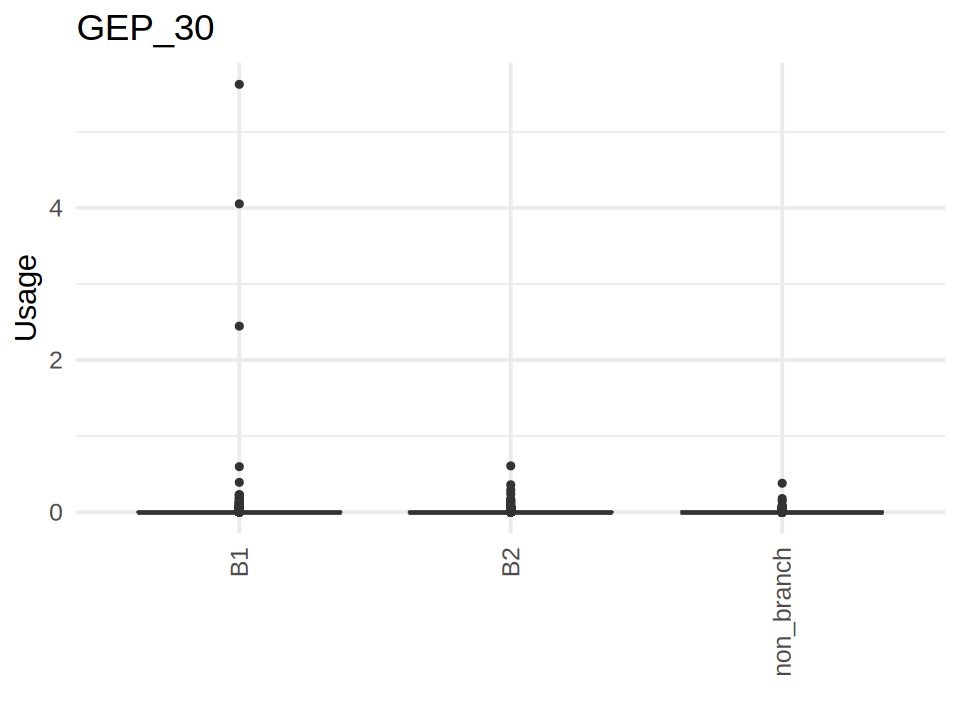

In [52]:
for (i in seq(1,30)){
    plot_box(rc.integrated_tricycle$branch.anno, GEP_usage[,which(colnames(GEP_usage)==paste0("GEP_",i))], paste0("GEP_",i))
}

## Redo GO analysis based on Che-Wei's annotated gene score
Note: Each gene is "uniquely" assigned to a GEP according to the maximum spectra score. This is different from the GO analysis at the top of this notebook

In [63]:
# Read in the table sent by Che-Wei
topgene_new <- read.table("/resnick/groups/NolanLab/cchen/mannitol/cnmf/20250722_root_atlas_cnmf/20250722_root_atlas_cnmf_parallel.gene_spectra_score.k_30.dt_0_1_annotated.csv", 
                          sep = ",", header = T)


In [64]:
head(topgene_new)

,Gene,GEP,Score,Rank,GEP_1,GEP_2,GEP_3,GEP_4,GEP_5,GEP_6,⋯,GEP_21,GEP_22,GEP_23,GEP_24,GEP_25,GEP_26,GEP_27,GEP_28,GEP_29,GEP_30
,<chr>,<chr>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,AT5G10130,GEP_1,0.010744356,1,0.010744356,-0.0008624264,0.0001573072,-0.0006713004,-0.0004445188,-0.0005884634,⋯,-0.0009504691,-0.0003566541,-0.0002891213,-0.0005385907,-4.006435e-04,-0.0003388148,-1.974402e-04,3.455496e-04,-1.135266e-05,1.207177e-05
2,AT1G54010,GEP_1,0.010546958,2,0.010546958,-0.0008080902,-0.0019291850,-0.0004139522,-0.0003636033,-0.0003578989,⋯,-0.0005263718,-0.0002254895,-0.0001939703,-0.0008099247,-2.177211e-04,-0.0002100479,-9.531763e-05,-2.833073e-04,-7.620894e-06,-5.608816e-05
3,AT4G37160,GEP_1,0.009257320,3,0.009257320,-0.0006513025,-0.0018881698,-0.0004673227,-0.0003987495,-0.0003797449,⋯,-0.0006345073,-0.0002493222,-0.0002003414,-0.0005243768,-2.007795e-04,-0.0002302973,-1.496550e-04,4.349926e-05,-4.744473e-06,-4.218373e-05
4,AT2G43610,GEP_1,0.009035509,4,0.009035509,-0.0009237657,0.0023933135,-0.0007111237,-0.0004347504,-0.0007563979,⋯,0.0007124570,-0.0004236274,-0.0003099640,-0.0004532029,-1.701928e-05,-0.0003550987,-3.042865e-04,-2.959266e-04,-2.049222e-05,-8.879225e-05
5,AT2G23630,GEP_1,0.009001678,5,0.009001678,-0.0007681538,-0.0014747042,-0.0003174310,-0.0002980285,-0.0002739272,⋯,-0.0004022242,-0.0001707945,-0.0001672692,-0.0009164677,-1.296692e-04,-0.0001814244,-1.247627e-04,-8.952755e-04,-7.551204e-06,-5.740698e-05
6,AT5G58784,GEP_1,0.008988829,6,0.008988829,-0.0008927577,-0.0017674511,-0.0002883207,-0.0002539218,-0.0002668609,⋯,-0.0001599409,-0.0001422679,-0.0001486489,-0.0011483766,-1.614805e-04,-0.0001608135,-2.005580e-04,-4.820686e-04,-1.330476e-05,-5.505679e-05


In [66]:
# Select rank 1 ~ 200 genes for each GEP
topgene_new_top <- topgene_new %>%
   dplyr::select(1:4) %>%
   filter(Rank %in% c(1:200))

In [68]:
head(topgene_new_top)
nrow(topgene_new_top)

,Gene,GEP,Score,Rank
,<chr>,<chr>,<dbl>,<int>
1,AT5G10130,GEP_1,0.010744356,1
2,AT1G54010,GEP_1,0.010546958,2
3,AT4G37160,GEP_1,0.009257320,3
4,AT2G43610,GEP_1,0.009035509,4
5,AT2G23630,GEP_1,0.009001678,5
6,AT5G58784,GEP_1,0.008988829,6


[1] 6000

In [69]:
# Convert into a list
GEP_list <- topgene_new_top %>%
  group_by(GEP) %>%
  summarise(genes = list(Gene), .groups = "drop") %>%
  deframe() #  convert a two-column df into a named list

In [77]:
class(GEP_list)

[1] "list"

In [74]:
GEP_list

$GEP_1
  [1] "AT5G10130" "AT1G54010" "AT4G37160" "AT2G43610" "AT2G23630" "AT5G58784"
  [7] "AT1G28290" "AT1G54030" "AT1G80240" "AT3G04320" "AT5G35940" "AT3G16410"
 [13] "AT2G43600" "AT5G13870" "AT2G41800" "AT4G15300" "AT2G47140" "AT2G17280"
 [19] "AT5G12940" "AT2G04160" "AT5G62340" "AT1G14220" "AT1G06330" "AT4G23590"
 [25] "AT4G01770" "AT4G01950" "AT3G14530" "AT1G54000" "AT1G07175" "AT1G78340"
 [31] "AT5G60520" "AT3G29430" "AT2G30340" "AT5G26260" "AT4G21902" "AT4G14560"
 [37] "AT5G26280" "AT4G38140" "AT1G44318" "AT2G25980" "AT5G47950" "AT4G24340"
 [43] "AT1G66280" "AT3G14550" "AT4G15350" "AT5G02260" "AT4G15215" "AT3G20940"
 [49] "AT1G12740" "AT5G40780" "AT1G66400" "AT3G16420" "AT1G66800" "AT3G16450"
 [55] "AT1G44760" "AT5G44440" "AT2G43535" "AT5G36880" "AT4G01240" "AT1G14080"
 [61] "AT3G16430" "AT5G63650" "AT4G16500" "AT5G26230" "AT1G72140" "AT4G30610"
 [67] "AT2G39350" "AT2G35770" "AT4G30810" "AT1G01720" "AT1G22190" "AT5G24070"
 [73] "AT4G20000" "AT5G08590" "AT5G66690" "AT5G66800" "AT5G41810" "AT4G36010"
 [79] "AT4G31320" "AT4G24275" "AT3G10720" "AT4G00360" "AT1G02390" "AT3G62650"
 [85] "AT2G40470" "AT3G51600" "AT4G00400" "AT3G14510" "AT4G30080" "AT1G33750"
 [91] "AT5G23820" "AT1G31950" "AT2G45050" "AT1G73340" "AT4G36250" "AT1G47620"
 [97] "AT4G11610" "AT1G23160" "AT3G15950" "AT2G23110" "AT3G47380" "AT3G16460"
[103] "AT1G65730" "AT2G38750" "AT3G46080" "AT1G74490" "AT1G52690" "AT5G15265"
[109] "AT1G55850" "AT3G45730" "AT2G32190" "AT5G57090" "AT3G07320" "AT1G69040"
[115] "AT3G46700" "AT5G39080" "AT1G48330" "AT2G41290" "AT5G37770" "AT3G59850"
[121] "AT4G31290" "AT5G66460" "AT5G42630" "AT4G37770" "AT5G10480" "AT5G14730"
[127] "AT3G45600" "AT5G59030" "AT3G05500" "AT2G38940" "AT5G56980" "AT2G43290"
[133] "AT4G20820" "AT2G14960" "AT2G39200" "AT1G50720" "AT3G15810" "AT3G19930"
[139] "AT2G40475" "AT5G07040" "AT1G32540" "AT2G22770" "AT2G32210" "AT4G04745"
[145] "AT1G52910" "AT3G23470" "AT1G10560" "AT3G10815" "AT5G23840" "AT4G39660"
[151] "AT1G80830" "AT5G06320" "AT3G49630" "AT2G20515" "AT1G07280" "AT5G14750"
[157] "AT3G44450" "AT4G15760" "AT2G30130" "AT3G45310" "AT5G24610" "AT1G65980"
[163] "AT5G42600" "AT1G14210" "AT5G65683" "AT2G24570" "AT1G80370" "AT5G48940"
[169] "AT2G39210" "AT4G33120" "AT5G62180" "AT2G38760" "AT2G14820" "AT3G54200"
[175] "AT1G80110" "AT4G15280" "AT3G56710" "AT1G11000" "AT5G50180" "AT3G01516"
[181] "AT4G16230" "AT5G56320" "AT3G20590" "AT1G19310" "AT5G58750" "AT3G03640"
[187] "AT3G24503" "AT2G38120" "AT3G52748" "AT5G14800" "AT2G20370" "AT4G12840"
[193] "AT1G07290" "AT1G10810" "AT5G65690" "AT3G52500" "AT5G65925" "AT2G21130"
[199] "AT3G48260" "AT3G50760"

$GEP_10
  [1] "AT1G05260" "AT4G11290" "AT5G57620" "AT2G22000" "AT4G05100" "AT2G14900"
  [7] "AT5G65790" "AT4G22110" "AT1G69930" "AT1G22640" "AT3G17820" "AT4G16447"
 [13] "AT5G38790" "AT4G18930" "AT5G20820" "AT2G36890" "AT5G01595" "AT3G04520"
 [19] "AT3G45070" "AT2G37180" "AT3G59620" "AT2G37170" "AT3G32980" "AT2G47930"
 [25] "AT1G72940" "AT2G48030" "AT1G01360" "AT3G01513" "AT1G72630" "AT5G28020"
 [31] "AT5G63595" "AT3G22600" "AT1G09560" "AT1G13420" "AT1G17190" "AT3G11660"
 [37] "AT1G19840" "AT3G43800" "AT3G16240" "AT1G49660" "AT1G16390" "AT2G16750"
 [43] "AT5G04120" "AT5G49800" "AT1G16370" "AT1G14580" "AT5G59590" "AT5G64570"
 [49] "AT3G10525" "AT2G44790" "AT1G25230" "AT2G36307" "AT2G45960" "AT4G26320"
 [55] "AT3G02780" "AT4G16270" "AT5G28010" "AT4G16380" "AT5G45210" "AT3G50800"
 [61] "AT1G31935" "AT2G16720" "AT4G36640" "AT3G18820" "AT2G43340" "AT4G17280"
 [67] "AT4G32710" "AT1G68570" "AT3G30180" "AT5G25770" "AT3G19030" "AT5G05180"
 [73] "AT3G55770" "AT5G63660" "AT4G24220" "AT2G23560" "AT5G46600" "AT3G56230"
 [79] "AT3G02770" "AT4G14040" "AT1G09090" "AT3G24450" "AT5G57150" "AT1G08847"
 [85] "AT5G62500" "AT5G06730" "AT5G16390" "AT4G03610" "AT5G60460" "AT1G02205"
 [91] "AT4G17300" "AT1G09812" "AT5G47370" "AT4G39030" "AT3G44870" "AT2G25160"
 [97] "AT3G10985" "AT3G09032" "AT3G54400" "AT3G23730" "AT5G61130" "AT1G55330"
[103] "AT1G22650" "AT4G11190" "AT1G76690" "AT1G10200" 

In [75]:
length(GEP_list)
length(GEP_list[[1]])

[1] 30

[1] 200

In [78]:
# Perform GO analysis
cluster_GO <- gost(GEP_list, organism = "athaliana", correction_method = "fdr", significant = F, multi_query = F)

cluster_GO_df <- cluster_GO[[1]] # the result data frame

cluster_GO_sig <- filter(cluster_GO_df, p_value<=0.01)

In [79]:
head(cluster_GO_sig, 3)

,query,significant,p_value,term_size,query_size,intersection_size,precision,recall,term_id,source,term_name,effective_domain_size,source_order,parents
,<chr>,<lgl>,<dbl>,<int>,<int>,<int>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<int>,<int>,<list>
1,GEP_1,TRUE,1.130733e-07,900,145,25,0.1724138,0.02777778,GO:0005911,GO:CC,cell-cell junction,20029,426,GO:0070161
2,GEP_1,TRUE,1.130733e-07,900,145,25,0.1724138,0.02777778,GO:0030054,GO:CC,cell junction,20029,844,GO:0110165
3,GEP_1,TRUE,1.130733e-07,900,145,25,0.1724138,0.02777778,GO:0070161,GO:CC,anchoring junction,20029,2375,GO:0030054


In [80]:
sort(unique(cluster_GO_sig$query))

[1] "GEP_1"  "GEP_10" "GEP_11" "GEP_12" "GEP_13" "GEP_14" "GEP_15" "GEP_16"
 [9] "GEP_17" "GEP_18" "GEP_19" "GEP_2"  "GEP_20" "GEP_21" "GEP_22" "GEP_23"
[17] "GEP_24" "GEP_25" "GEP_26" "GEP_27" "GEP_28" "GEP_29" "GEP_3"  "GEP_30"
[25] "GEP_4"  "GEP_5"  "GEP_6"  "GEP_7"  "GEP_8"  "GEP_9"

In [81]:
# top  terms for each cluster

cluster_GO_sig %>%
  filter(source=="GO:BP", intersection_size>=4) %>%
  group_by(query) %>%
  top_n(5, wt = -p_value) %>%
  arrange(desc(p_value)) -> top_GO

GO_n <- cluster_GO_sig %>%
  filter(source=="GO:BP", intersection_size>=4) %>%
  group_by(term_id) %>%
  tally() %>%
  arrange(desc(n))


GO_n <- dplyr::rename(GO_n, "n_clusters"=n)

cluster_GO_sig_n <- left_join(cluster_GO_sig, GO_n)

# get all terms for the top ones so that all clusters have values

top_GO_all <- filter(cluster_GO_df, term_id %in% top_GO$term_id)


#spread and plot


top_GO_sel <- select(top_GO_all, query, p_value, term_id, term_name)

spread_GO <- spread(top_GO_sel, key = query, p_value)

spread_GO[is.na(spread_GO)] <- 1

spread_GO_m <- as.matrix(-log10(spread_GO[3:ncol(spread_GO)]))
rownames(spread_GO_m) <- spread_GO$term_name

Joining with `by = join_by(term_id)`


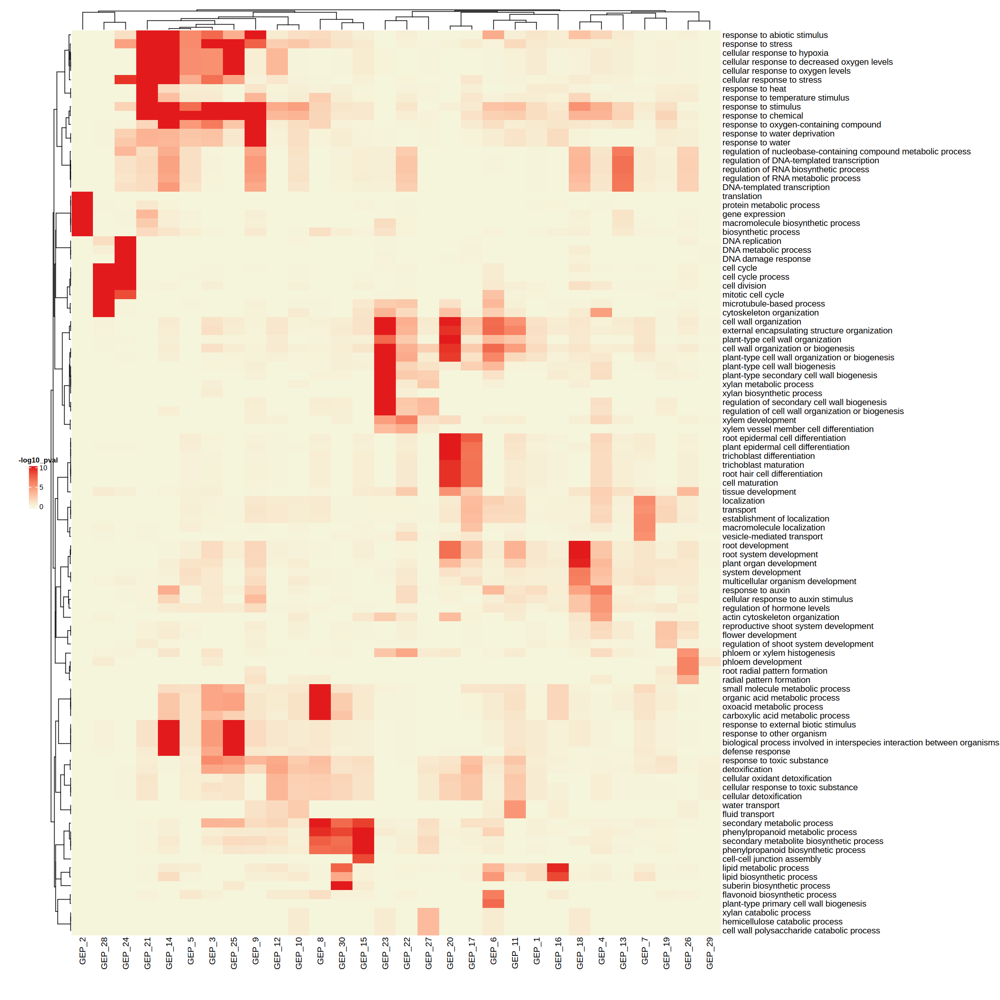

In [82]:
options(repr.plot.width = 20, repr.plot.height = 20)

GO_hm <- Heatmap(spread_GO_m, 
                 name = "-log10_pval", 
                 heatmap_legend_param = list(title_position="topcenter", color_bar = "continuous"), 
                 col = colorRamp2(c(0, 10), 
                                  c("beige", "#e31a1c")), 
                 cluster_rows = T,
                 cluster_columns = T, 
                 use_raster= FALSE, 
                 show_column_names = TRUE, 
                 show_row_names = TRUE, 
                 show_row_dend = TRUE, 
                 show_column_dend = TRUE, 
                 clustering_distance_rows = "pearson",
                 clustering_distance_columns = "pearson", 
                 row_names_gp = gpar(fontsize = 12)) 


# padding - bottom, left, top, right
draw(GO_hm, padding = unit(c(15, 15, 5, 80), "mm"), heatmap_legend_side = "left")

In [83]:
getwd()

[1] "/resnick/groups/NolanLab/cchen/mannitol/cnmf/20250722_root_atlas_cnmf"

In [84]:
head(spread_GO)

,term_id,term_name,GEP_1,GEP_10,GEP_11,GEP_12,GEP_13,GEP_14,GEP_15,GEP_16,⋯,GEP_28,GEP_29,GEP_3,GEP_30,GEP_4,GEP_5,GEP_6,GEP_7,GEP_8,GEP_9
,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,GO:0000278,mitotic cell cycle,0.7544654,1.00000000,0.72159479,1.0000000,1.000000e+00,1.000000e+00,1.0000000,1.00000000,⋯,5.369333e-31,1.0000000,1.000000e+00,1.000000000,1.0000000,1.00000000,0.002066333,1.0000000,1.00000e+00,1.000000e+00
2,GO:0006082,organic acid metabolic process,0.7320431,0.09969248,0.08484514,0.2773667,4.627266e-01,3.084666e-03,0.2391860,0.02186969,⋯,1.000000e+00,1.0000000,6.365655e-05,0.006505986,0.9323475,0.11352744,0.317255384,0.1264501,7.29419e-19,1.472614e-01
3,GO:0006259,DNA metabolic process,1.0000000,0.98763095,1.00000000,1.0000000,1.000000e+00,1.000000e+00,0.9943347,1.00000000,⋯,4.573967e-01,0.8782392,9.930923e-01,1.000000000,1.0000000,1.00000000,1.000000000,1.0000000,1.00000e+00,9.878100e-01
4,GO:0006260,DNA replication,1.0000000,0.76940804,1.00000000,1.0000000,1.000000e+00,1.000000e+00,1.0000000,1.00000000,⋯,5.410571e-02,0.9473830,1.000000e+00,1.000000000,1.0000000,1.00000000,1.000000000,1.0000000,1.00000e+00,1.000000e+00
5,GO:0006351,DNA-templated transcription,0.9246501,0.18266163,1.00000000,1.0000000,2.147645e-07,1.245284e-05,0.5334849,0.98207254,⋯,9.710182e-01,1.0000000,7.959725e-01,0.746753210,0.1747997,0.11491785,0.975451039,0.4291415,1.00000e+00,7.687229e-05
6,GO:0006355,regulation of DNA-templated transcription,0.8744609,0.11814886,1.00000000,1.0000000,1.084141e-07,3.726429e-05,0.4192784,0.95540202,⋯,9.710182e-01,1.0000000,6.965372e-01,0.647233471,0.1085750,0.07235404,0.932478184,0.3297585,1.00000e+00,1.327075e-05


In [85]:
# Save the result
#write.table(spread_GO,
#            "20250722_root_atlas_cnmf_parallel.gene_spectra_score.k_30.dt_0_1_annotated_by_CheWei_GO.txt", sep = "\t",
#            row.names = F, col.names = T, quote = F)